<a href="https://colab.research.google.com/github/Lucile-S/ART_project/blob/main/WCGAN_Painting_by_ARTIST_V1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## packages

In [ ]:
!pip install tensorboard
!pip install "tqdm==4.43.0"
import os
from time import sleep
from tqdm import tqdm
from glob import iglob
import pandas as pd
import pandas as pd

from collections import Counter
import itertools

import torch
import torch.nn as nn
import torch.optim as optim
import torchvision
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torch.utils.tensorboard import SummaryWriter
import matplotlib.pyplot as plt
import numpy as np
from torchvision.utils import make_grid
from torch.utils.data import Dataset
from torchvision.utils import save_image
from torch.utils.data import random_split
import torchvision.transforms as transforms
from torchvision.datasets.folder import default_loader
from torchvision.utils import save_image
from PIL import Image
import cv2
import copy
import urllib
import time
from datetime import datetime
import collections 

%matplotlib inline

     |████████████████████████████████| 59 kB 5.9 MB/s 
  Attempting uninstall: tqdm
    Found existing installation: tqdm 4.62.0
    Uninstalling tqdm-4.62.0:
      Successfully uninstalled tqdm-4.62.0
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
panel 0.12.1 requires tqdm>=4.48.0, but you have tqdm 4.43.0 which is incompatible.


## Classes

In [ ]:
class Artist(object):
    """
    Artist Object
    """
    def __init__(self, folder_path:str, label_id=None ):
        self._path = folder_path.replace('\\',r'/')
        self._label_id = label_id

    @property
    def folder_name(self):
        return os.path.basename(self._path)

    @property
    def name(self):
      return os.path.basename(self._path).replace('-',' ').title()

    @property
    def path(self):
        return self._path
    
    @property
    def painting_paths(self):
        return list(iglob(self._path + '/*.jpg'))

    @property
    def painting_titles(self):
        return [ os.path.basename(painting_path).replace('.jpg','').replace('-',' ').capitalize() for painting_path in iglob(self._path + '/*.jpg') ]

    @property
    def painting_nb(self):
      return len(list(iglob(self._path + '/*.jpg')))

    @property
    def label(self):
        # just one label_id
        if isinstance(self._label_id, int):
            return self._label_id
        # sample associated with multiple labels
        else:
            return [int(label_id) for label_id in self._label_id]
  

class Painting(object):
    """
    Painting Object
    """
    def __init__(self, painting_path:str):
        self._path = painting_path.replace('\\',r'/')
        self._json = self._path.replace('.jpg','.json')
        self._data = open_json_file(self._json)
        self._filename = os.path.basename(self._json).replace('.json','')
        self._key = list(self._data.keys())[0]

    @property
    def data(self):
      return  self._data


    @property
    def filename(self):
      return  self._filename


    @property
    def name(self):
      return  self._data[self._key]['Name']

    @property
    def artist(self):
      return  self._data[self._key]['Artist']


    @property
    def date(self):
      return self._data[self._key]['Date']
  
  
    @property
    def style(self):
      return self._data[self._key]['Style']
    
    @property
    def genre(self):
      return self._data[self._key]['Genre']

        
    @property
    def tags(self):
      return self._data[self._key]['Tags']

class Art_Dataset(Dataset):
    """
    Args:
        image_paths (list): list of image paths.
        df (pandas dataframe) : dataframe containning images names and encoding labels 
        classes (list): list of classes.
        transform (callable, optional): Optional transform to be applied on a sample.
    """
    def __init__(self, image_paths:list, labels:list, transform =None):
      self.image_paths = image_paths
      self.labels = labels 
      self.transform  = transform

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, index):
        #print(f'--- GET ITEM  # {index} ---')
        image_path = self.image_paths[index]
        image = Image.open(image_path).convert('RGB') 
        label =  self.labels[index]
        if self.transform:
            image = self.transform(image)
        return image, label, image_path


class CustomResize(object):
    def __init__(self, size, interpolation=Image.BILINEAR):
        self.size = size
        self.interpolation = interpolation

    def __call__(self, img):
        old_size = img.size  # old_size[0] is in (width, height) format

        ratio = float(self.size)/min(old_size)
        new_size = tuple([int(x * ratio) for x in old_size])

        return img.resize(new_size, resample=self.interpolation)

## utils

In [ ]:
## utils

def MakeDir(DIR:str) -> None:
    try:
        if not os.path.exists(DIR):
            os.makedirs(DIR)
    except OSError as err:
        print(err)
        pass

def show_batch(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    try: 
      image_unflat = image_tensor.detach().cpu()
    except: 
      image_unflat = image_tensor
      
    plt.figure(figsize = (12,12))
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

def gradient_penalty(critic, labels, real, fake, device="cpu"):
    BATCH_SIZE, C, H, W = real.shape
    alpha = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)
    interpolated_images = real * alpha + fake * (1 - alpha)

    # Calculate critic scores
    mixed_scores = critic(interpolated_images, labels)

    # Take the gradient of the scores with respect to the images
    gradient = torch.autograd.grad(
        inputs=interpolated_images,
        outputs=mixed_scores,
        grad_outputs=torch.ones_like(mixed_scores),
        create_graph=True,
        retain_graph=True,
    )[0]
    gradient = gradient.view(gradient.shape[0], -1)
    gradient_norm = gradient.norm(2, dim=1)
    gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
    return gradient_penalty


def save_checkpoint(state, filename="celeba_wgan_gp.pth.tar"):
    print("=> Saving checkpoint")
    torch.save(state, filename)


def load_checkpoint(checkpoint, gen, disc):
    print("=> Loading checkpoint")
    gen.load_state_dict(checkpoint['gen'])
    disc.load_state_dict(checkpoint['disc'])
    

def show_tensor_images(image_tensor, num_images=25, size=(1,64, 64), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

def save_samples(index, epoch, fixed_noise, fixed_labels,  stats , sample_dir = '.', resize_size=128, show=True):
    fake_images = gen(fixed_noise, fixed_labels)
    fake_fname = f'Wcgan-byartist-generated-images-{index:0=5d}-epoch-{epoch:0=4d}.jpg'
    save_image(denorm(transforms.Resize(resize_size)(fake_images), stats).clamp(0, 1), os.path.join(sample_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(denorm(fake_images.detach().cpu(), stats), nrow=8).permute(1, 2, 0).squeeze())
        plt.show()


def denorm(img_tensors, stats):
    return img_tensors * stats[1][0] + stats[0][0]


## Models

In [ ]:
"""
Discriminator and Generator implementation from DCGAN paper
"""

class Discriminator(nn.Module):
    def __init__(self, channels_img, features_d, num_classes,  img_size):
        super(Discriminator, self).__init__()
        self.img_size = img_size
        self.channels_img = channels_img
        self.disc = nn.Sequential(
            # input: N x channels_img x 64 x 64
            nn.Conv2d(self.channels_img + num_classes , features_d, kernel_size=4, stride=2, padding=1),
            #nn.Conv2d(self.channels_img +1 , features_d, kernel_size=4, stride=2, padding=1),
            nn.LeakyReLU(0.2),
            # _block(in_channels, out_channels, kernel_size, stride, padding)
            self._block(features_d, features_d * 2, 4, 2, 1),
            self._block(features_d * 2, features_d * 4, 4, 2, 1),
            self._block(features_d * 4, features_d * 8, 4, 2, 1),
            # After all _block img output is 4x4 (Conv2d below makes into 1x1)
            nn.Conv2d(features_d * 8, 1, kernel_size=4, stride=2, padding=0),
        )
        self.embed = nn.Embedding(num_classes, num_classes)
        #self.embed = nn.Embedding(num_classes, img_size*img_size)


    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.Conv2d(
                in_channels, out_channels, kernel_size, stride, padding, bias=False,
            ),
            nn.InstanceNorm2d(out_channels, affine=True),
            nn.LeakyReLU(0.2),
        )

    def forward(self, x, labels):
        #embedding =  self.embed(labels).view(labels.shape[0], self.channels_img, self.img_size, self.img_size) # it's like an additional channel ; # N x C x H x W
        embedding =   self.embed(labels)[:,:,None,None].repeat(1, 1, self.img_size, self.img_size) # N x N_classes x IMG_SIZE x IMG_siSE
       
        x = torch.cat([x, embedding], dim=1)

        return self.disc(x)


class Generator(nn.Module):
    def __init__(self, channels_noise, channels_img, features_g, num_classes, img_size, embed_size):
        super(Generator, self).__init__()
        self.img_size = img_size
        self.net = nn.Sequential(
            # Input: N x channels_noise x 1 x 1
            self._block(channels_noise + embed_size, features_g * 16, 4, 1, 0),  # img: 4x4
            self._block(features_g * 16, features_g * 8, 4, 2, 1),  # img: 8x8
            self._block(features_g * 8, features_g * 4, 4, 2, 1),  # img: 16x16
            self._block(features_g * 4, features_g * 2, 4, 2, 1),  # img: 32x32
            nn.ConvTranspose2d(
                features_g * 2, channels_img, kernel_size=4, stride=2, padding=1
            ),
            # Output: N x channels_img x 64 x 64
            nn.Tanh(),
        )
        self.embed = nn.Embedding(num_classes,embed_size)
        #self.embed = nn.Embedding(num_classes,num_classes)

    def _block(self, in_channels, out_channels, kernel_size, stride, padding):
        return nn.Sequential(
            nn.ConvTranspose2d(
                in_channels, out_channels, kernel_size, stride, padding, bias=False,
            ),
            nn.BatchNorm2d(out_channels),
            nn.ReLU(),
        )

    def forward(self, x, labels):
        embedding = self.embed(labels).unsqueeze(2).unsqueeze(3)
        x = torch.cat([x, embedding], dim=1)
        return self.net(x)


def initialize_weights(model):
    # Initializes weights according to the DCGAN paper
    for m in model.modules():
        if isinstance(m, (nn.Conv2d, nn.ConvTranspose2d, nn.BatchNorm2d)):
            nn.init.normal_(m.weight.data, 0.0, 0.02)


## Data

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# this creates a symbolic link so that now the path /content/gdrive/My\ Drive/ is equal to /mydrive
!ln -s /content/gdrive/MyDrive/ /mydrive

%cd mydrive

!ls /mydrive/GAN/

[Errno 2] No such file or directory: 'mydrive'
/content
Data  generated  logs  Models


In [ ]:
!ls /mydrive/GAN/Data

amedeo-modigliani      gustav-klimt		      pierre-auguste-renoir
arnold-bocklin	       henri-matisse		      piet-mondrian
artemisia-gentileschi  henri-rousseau		      rembrandt
Artists.csv	       john-james-audubon	      sandro-botticelli
claude-monet	       joseph-mallord-william-turner  theophile-steinlen
david-burliuk	       katsushika-hokusai	      vassily-kandinsky
edward-hopper	       pablo-picasso		      vincent-van-gogh
ernst-ludwig-kirchner  Paintings.csv		      zdzislaw-beksinski


In [ ]:
# -----------#
#    DATA    #
# -----------#
BY_GENRE = False
BY_ARTIST= True

# -- image Directory 
DIR = '/mydrive/GAN' 
img_DIR = os.path.join(DIR,'Data')
artist_paths =  [ artist_path for artist_path  in iglob(img_DIR +'/*') if os.path.isdir(artist_path)]
# -- list of Artist instance
ARTISTS  = [Artist(artist_path) for artist_path in artist_paths]
print(f'There are {len(artist_paths)} artists')
print(artist_paths)

artist_csv_path = os.path.join(img_DIR, 'Artists.csv')
df_artist = pd.read_csv(artist_csv_path, sep=";")
painting_csv_path = os.path.join(img_DIR, 'Paintings.csv')


## BY ARTIST ##
if BY_ARTIST:

    # -- create mapping dictionnary for Artist (in alphabetic order)
    artist_map_dic = {k: v for v, k in enumerate(sorted([ARTIST.name for ARTIST in ARTISTS ]))   }
    print(artist_map_dic)
    print(len(artist_map_dic))
  
    # -- save DIR   
    sample_dir = os.path.join(DIR,'generated','Wcgan','by_artist')
    os.makedirs(sample_dir, exist_ok=True)

    model_save_DIR = os.path.join(DIR,'Models','by_artist')
    os.makedirs(model_save_DIR , exist_ok=True)

    log_dir = os.path.join(DIR,'logs','Wcgan','by_artist')

    
    all_painting_paths = []
    all_labels  = []


    for artist_path in artist_paths:
        # -- create artist instance 
        artist = Artist(artist_path)
        #print(f'--{artist.name}--')
        artist_id =  artist_map_dic[artist.name]
        # -- get list of painting paths
        painting_paths = artist.painting_paths
        # -- add to all all_painting_paths 
        all_painting_paths.extend(painting_paths)
        all_labels.extend([artist_id] * artist.painting_nb)

    print(len(all_painting_paths))
    print(all_painting_paths[1000:1005])
    print(len(all_labels))
    print(all_labels[1000:1005])

There are 22 artists
['/mydrive/GAN/Data/zdzislaw-beksinski', '/mydrive/GAN/Data/rembrandt', '/mydrive/GAN/Data/arnold-bocklin', '/mydrive/GAN/Data/gustav-klimt', '/mydrive/GAN/Data/katsushika-hokusai', '/mydrive/GAN/Data/pablo-picasso', '/mydrive/GAN/Data/vincent-van-gogh', '/mydrive/GAN/Data/ernst-ludwig-kirchner', '/mydrive/GAN/Data/theophile-steinlen', '/mydrive/GAN/Data/joseph-mallord-william-turner', '/mydrive/GAN/Data/sandro-botticelli', '/mydrive/GAN/Data/amedeo-modigliani', '/mydrive/GAN/Data/artemisia-gentileschi', '/mydrive/GAN/Data/piet-mondrian', '/mydrive/GAN/Data/edward-hopper', '/mydrive/GAN/Data/pierre-auguste-renoir', '/mydrive/GAN/Data/claude-monet', '/mydrive/GAN/Data/henri-rousseau', '/mydrive/GAN/Data/henri-matisse', '/mydrive/GAN/Data/david-burliuk', '/mydrive/GAN/Data/john-james-audubon', '/mydrive/GAN/Data/vassily-kandinsky']
{'Amedeo Modigliani': 0, 'Arnold Bocklin': 1, 'Artemisia Gentileschi': 2, 'Claude Monet': 3, 'David Burliuk': 4, 'Edward Hopper': 5, 'Ern

### BY GENRE 

In [ ]:
if BY_GENRE:
    filename ='Paintings.csv'
    df = pd.read_csv(os.path.join(img_DIR,'Paintings.csv'), sep=';')
    print(df.tail(5))

    # -- convert Tags column to tuples
    # df['Tags'] = df['Tags'].apply(eval)

    # -- Genre
    Genres = df['Genre'].unique()
    print('Genres:', Genres)
    print(f'There are {len(Genres)}')

    print(df.groupby('Genre')['Filename'].count())

    # -- Tags
    # --- replace empty tags by NaN
    df['Tags'] = df['Tags'].replace('()', np.nan)
    all_Tags  = []

    for t in  list(df['Tags'].dropna().values) :
        t = t.replace(')', ',)') # because one elemnt tuple need to be in the form (item,)
        t = eval(t)
        if len(t) > 1:
            for item in t:
                all_Tags.append(item)
        else: 
            try:
                all_Tags.append(t[0])
            except:
                pass

    print(f'all_Tags {all_Tags[-5]}')
    # -- count frequency of tags
    print('')
    print('Tag counting : ')
    Tag_Counts = Counter(elem for elem in all_Tags)

    print(Tag_Counts)

    # -- select paintings by genre
    painting_by_genre ={}
    for genre in Genres:
        painting_list = list(df[df['Genre']==genre]['Filename'])
        if len(painting_list) > 50 :
            # -- add .jpg 
            painting_list = [painting for painting in painting_list]
            painting_by_genre[genre] = painting_list


    # -- create mapping dictionnary for Artist (in alphabetic order)
    genre_map_dic = {k: v for v, k in enumerate(sorted([genre for genre in painting_by_genre.keys()]))   }
    print('Genre map dic :', genre_map_dic)
    print('Number of genre:', len(painting_by_genre))
    # -- example of painting list for one giving genre 
    #print(painting_by_genre['figurative'])


    # -- save DIR   
    sample_dir = os.path.join(DIR,'generated','Wcgan','by_genre')
    os.makedirs(sample_dir, exist_ok=True)

    model_save_DIR = os.path.join(DIR,'Models','by_genre')
    os.makedirs(model_save_DIR , exist_ok=True)

    log_dir = os.path.join(DIR,'logs','Wcgan','by_genre')

    #all_painting_filenames = []
    all_painting_paths = []
    all_labels  = []

    #print(df[df['Filename']=='spring-1907']['Artist'].values[0])

    def get_painting_path(painting_filename):
        artist = df[df['Filename']==painting_filename]['Artist'].values[0]
        artist = str(artist).lower().replace(' ','-')
        painting_path  = os.path.join(img_DIR, artist, painting_filename+'.jpg')
        return painting_path 

    for genre in sorted(painting_by_genre.keys()):
        print(genre)
        genre_id =  genre_map_dic[genre]
        print(genre_id)
        # -- get list of painting paths
        painting_filenames = painting_by_genre[genre]
        painting_paths  = list(map(get_painting_path,painting_filenames))
        # -- add to all all_painting_paths 
        all_painting_paths.extend(painting_paths)
        all_labels.extend([genre_id] * len(painting_paths))
        print('---')


In [ ]:
print('-------------')
print(len(all_painting_paths))
print(all_painting_paths[3100:3105])
print(len(all_labels))
print(all_labels[3100:3105])

-------------
12404
['/mydrive/GAN/Data/pablo-picasso/two-nudes-and-a-cat-1903.jpg', '/mydrive/GAN/Data/pablo-picasso/portrait-of-fernande-olivier-in-headscarves-1906.jpg', '/mydrive/GAN/Data/pablo-picasso/the-corrida-1901.jpg', '/mydrive/GAN/Data/pablo-picasso/woman-with-cigarette-1903.jpg', '/mydrive/GAN/Data/pablo-picasso/portrait-of-gertrude-stein-1906.jpg']
12404
[13, 13, 13, 13, 13]


In [ ]:
if BY_ARTIST:
    NUM_CLASSES  = 22
if BY_GENRE:
    NUM_CLASSES = 17
BATCH_SIZE = 64
fixed_labels  = torch.tensor(list(np.arange(0,NUM_CLASSES))*6)[:BATCH_SIZE] # to have dim 64 
print(fixed_labels)
print('Lenght fixed labels :' , len(fixed_labels))

tensor([ 0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
        18, 19, 20, 21,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13,
        14, 15, 16, 17, 18, 19, 20, 21,  0,  1,  2,  3,  4,  5,  6,  7,  8,  9,
        10, 11, 12, 13, 14, 15, 16, 17, 18, 19])
Lenght fixed labels : 64


##  TRAIN

In [ ]:
# Hyperparameters etc.
device = "cuda" if torch.cuda.is_available() else "cpu"
LEARNING_RATE = 1.5e-4
BATCH_SIZE = 32
IMG_SIZE = 64
CHANNELS_IMG = 3
Z_DIM = 124
NUM_EPOCHS_START = 525
NUM_EPOCHS = NUM_EPOCHS_START + 400
FEATURES_CRITIC = 64
FEATURES_GEN = 64
CRITIC_ITERATIONS = 6
GENERATOR_ITERATIONS = 1
LAMBDA_GP = 10 # gradient penalty
GENERATOR_EMBEDDING  = NUM_CLASSES 
NUM_DISPLAY = 500
SAVE_EPOCH = 15

stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)
date = datetime.now().strftime("%Y_%m_%d")

transformations = transforms.Compose(
    [
        transforms.Resize((IMG_SIZE,IMG_SIZE)),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]),
    ]
)


# -- dataset dataloader
# --- artist 
dataset = Art_Dataset(all_painting_paths, all_labels, transform=transformations)

loader = DataLoader(dataset,
                    batch_size=BATCH_SIZE,
                    shuffle=True)

Saving Wcgan-byartist-generated-images-00388-epoch-0525.jpg


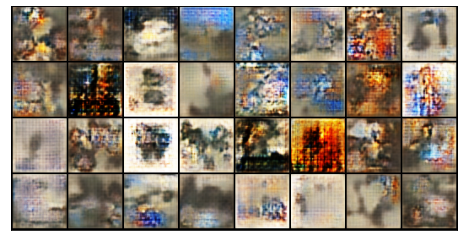

------------------------------------------------------------------------------------
Epoch [526/925] | Step 500 | Batch 112/388                   Loss G: -455.2575, loss D: -6.1999
--real images ---


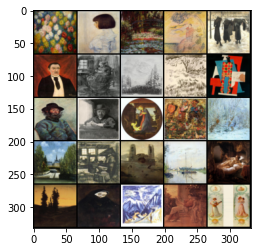

--fake images ---


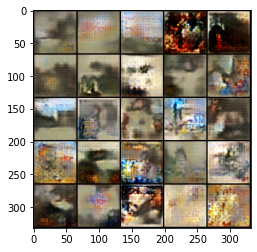

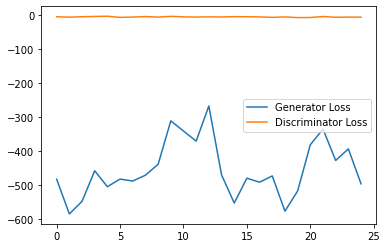

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-00500-epoch-0526.jpg
Epoch [527/925] | Step 1000 | Batch 224/388                   Loss G: -487.9838, loss D: -6.5330
--real images ---


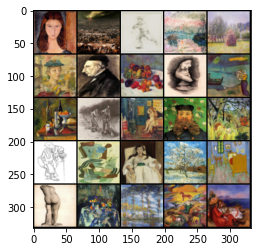

--fake images ---


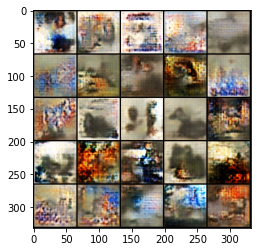

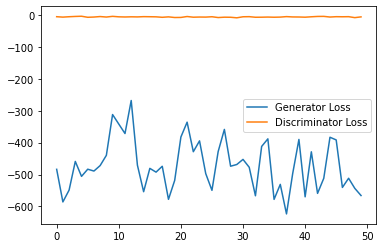

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-01000-epoch-0527.jpg
Epoch [528/925] | Step 1500 | Batch 336/388                   Loss G: -592.9494, loss D: -6.1190
--real images ---


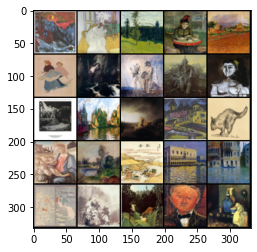

--fake images ---


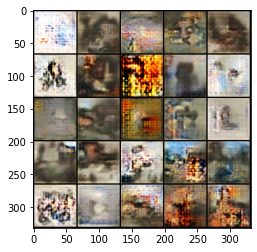

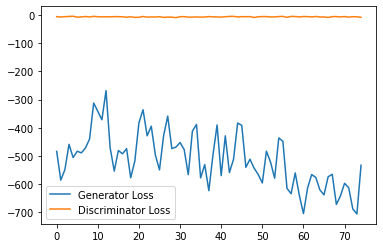

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-01500-epoch-0528.jpg
Epoch [530/925] | Step 2000 | Batch 60/388                   Loss G: -550.5353, loss D: -6.3922
--real images ---


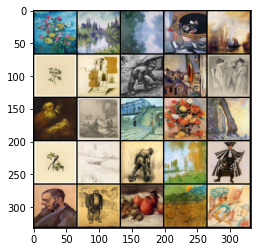

--fake images ---


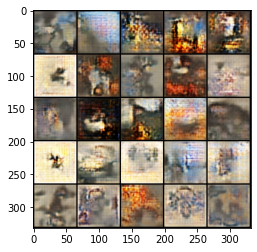

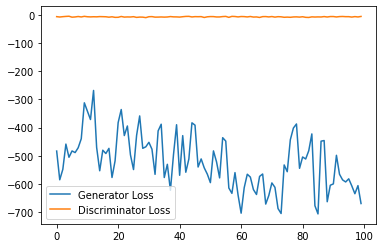

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-02000-epoch-0530.jpg
Epoch [531/925] | Step 2500 | Batch 172/388                   Loss G: -939.8346, loss D: -6.6894
--real images ---


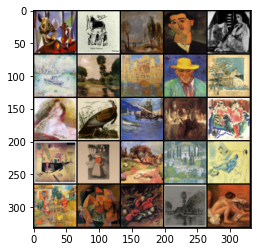

--fake images ---


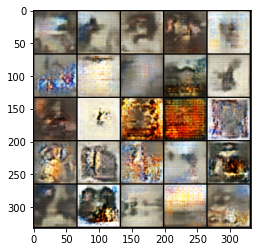

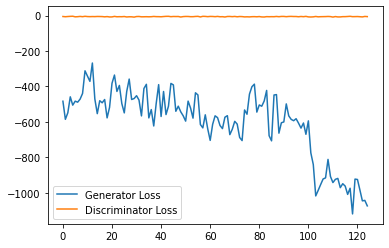

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-02500-epoch-0531.jpg
Epoch [532/925] | Step 3000 | Batch 284/388                   Loss G: -997.6850, loss D: -6.4472
--real images ---


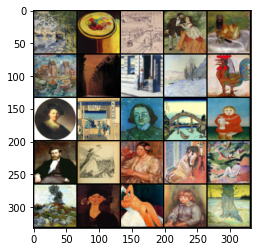

--fake images ---


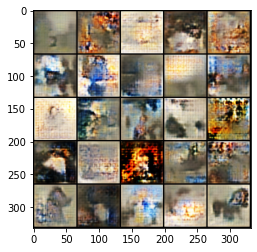

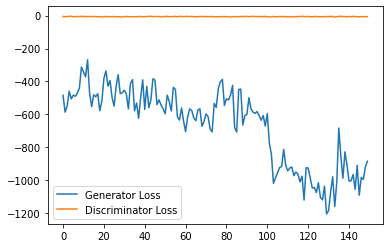

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-03000-epoch-0532.jpg
Epoch [534/925] | Step 3500 | Batch 8/388                   Loss G: -986.3439, loss D: -6.4332
--real images ---


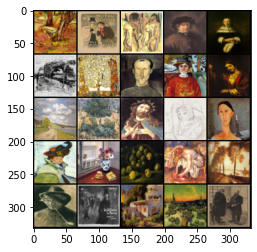

--fake images ---


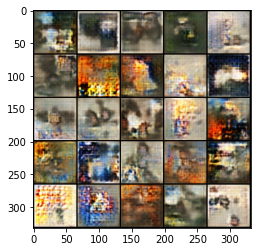

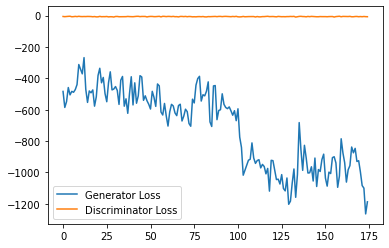

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-03500-epoch-0534.jpg
Epoch [535/925] | Step 4000 | Batch 120/388                   Loss G: -1020.0199, loss D: -6.2442
--real images ---


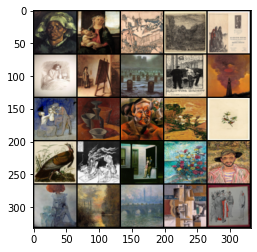

--fake images ---


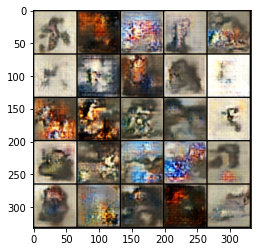

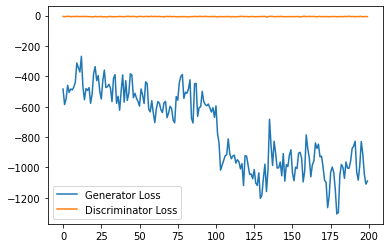

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-04000-epoch-0535.jpg
Epoch [536/925] | Step 4500 | Batch 232/388                   Loss G: -839.3557, loss D: -5.9917
--real images ---


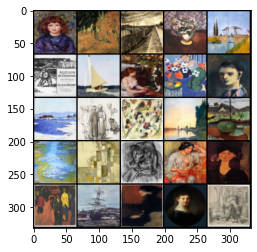

--fake images ---


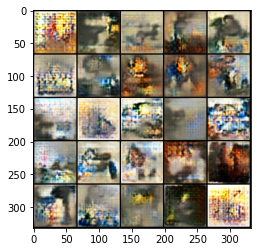

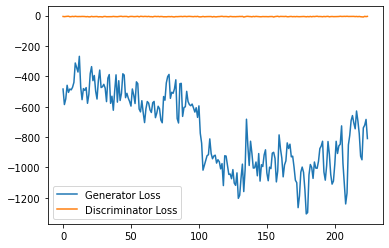

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-04500-epoch-0536.jpg
Epoch [537/925] | Step 5000 | Batch 344/388                   Loss G: -780.0904, loss D: -6.1981
--real images ---


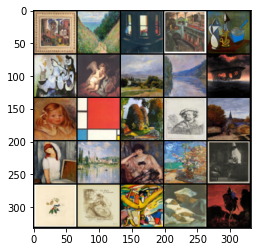

--fake images ---


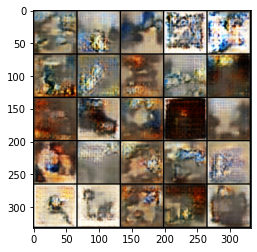

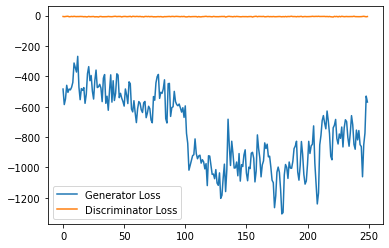

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-05000-epoch-0537.jpg
Epoch [539/925] | Step 5500 | Batch 68/388                   Loss G: -637.1257, loss D: -6.2358
--real images ---


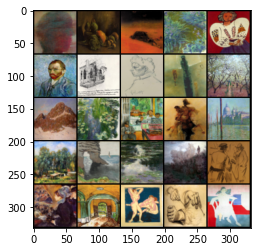

--fake images ---


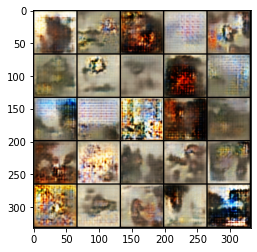

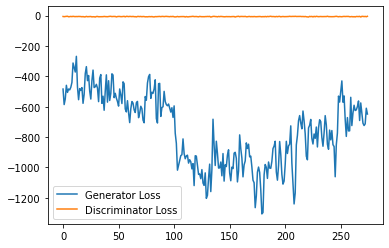

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-05500-epoch-0539.jpg
Epoch [540/925] | Step 6000 | Batch 180/388                   Loss G: -785.0788, loss D: -6.4877
--real images ---


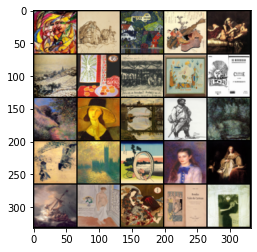

--fake images ---


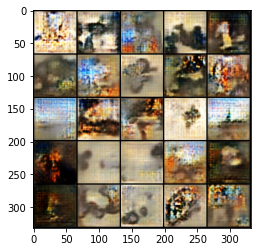

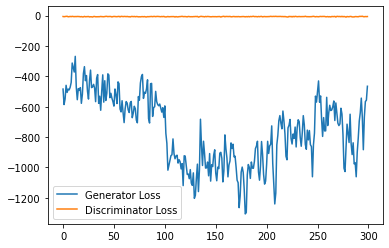

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-06000-epoch-0540.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0540.jpg


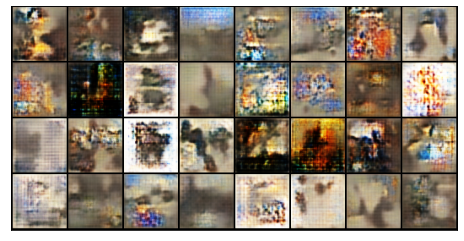

------------------------------------------------------------------------------------
Epoch [541/925] | Step 6500 | Batch 292/388                   Loss G: -589.7814, loss D: -6.2312
--real images ---


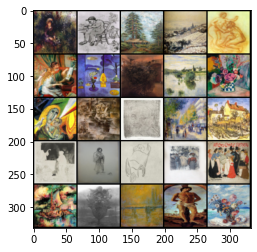

--fake images ---


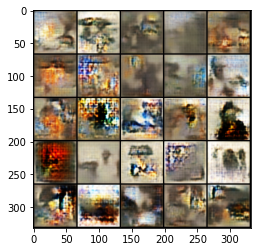

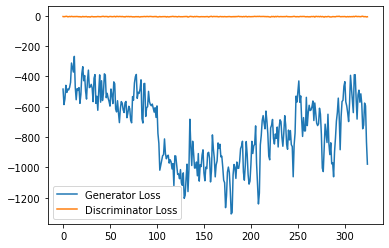

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-06500-epoch-0541.jpg
Epoch [543/925] | Step 7000 | Batch 16/388                   Loss G: -567.4894, loss D: -6.2420
--real images ---


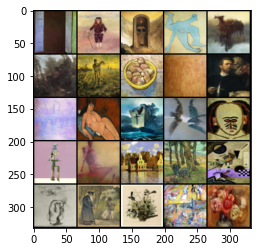

--fake images ---


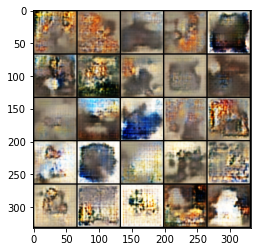

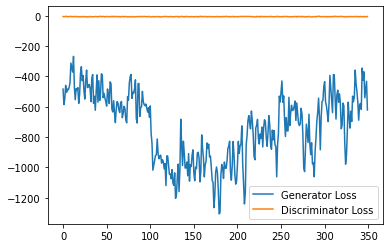

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-07000-epoch-0543.jpg
Epoch [544/925] | Step 7500 | Batch 128/388                   Loss G: -683.4153, loss D: -6.7650
--real images ---


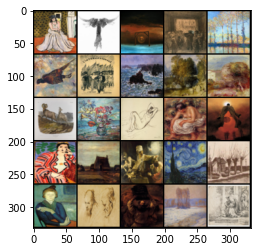

--fake images ---


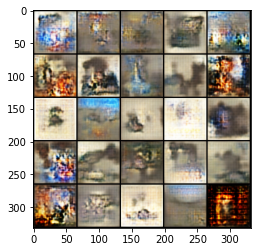

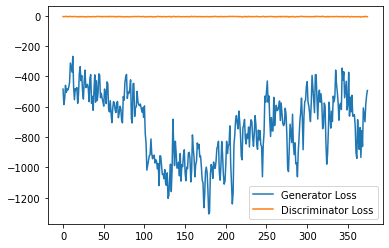

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-07500-epoch-0544.jpg
Epoch [545/925] | Step 8000 | Batch 240/388                   Loss G: -694.0530, loss D: -6.9070
--real images ---


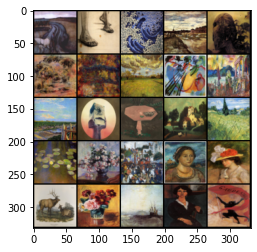

--fake images ---


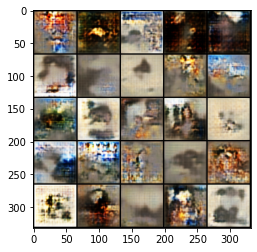

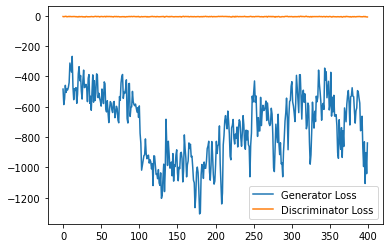

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-08000-epoch-0545.jpg
Epoch [546/925] | Step 8500 | Batch 352/388                   Loss G: -899.8774, loss D: -6.4582
--real images ---


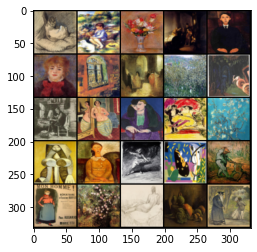

--fake images ---


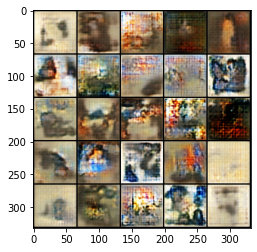

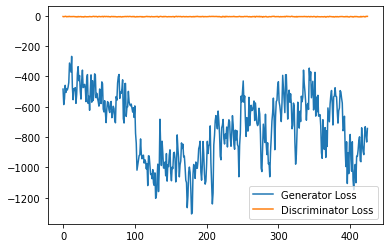

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-08500-epoch-0546.jpg
Epoch [548/925] | Step 9000 | Batch 76/388                   Loss G: -754.5398, loss D: -6.7773
--real images ---


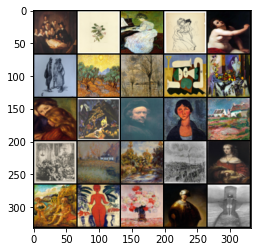

--fake images ---


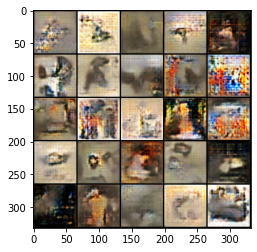

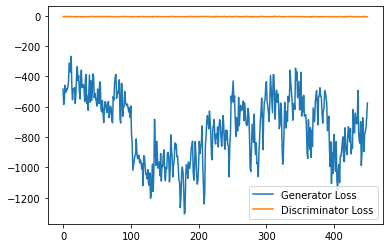

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-09000-epoch-0548.jpg
Epoch [549/925] | Step 9500 | Batch 188/388                   Loss G: -814.7379, loss D: -6.4039
--real images ---


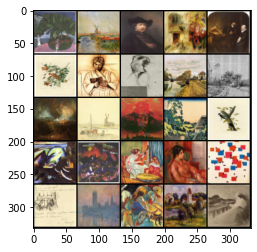

--fake images ---


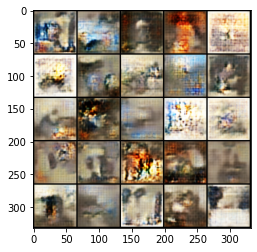

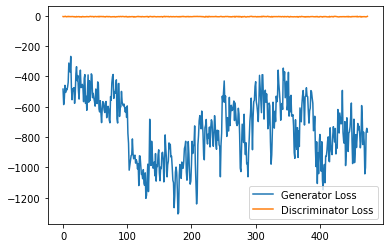

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-09500-epoch-0549.jpg
Epoch [550/925] | Step 10000 | Batch 300/388                   Loss G: -658.3074, loss D: -6.5651
--real images ---


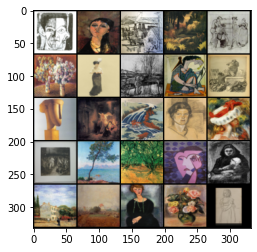

--fake images ---


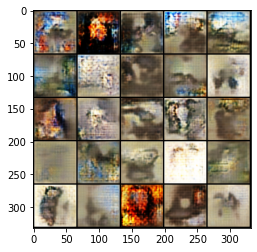

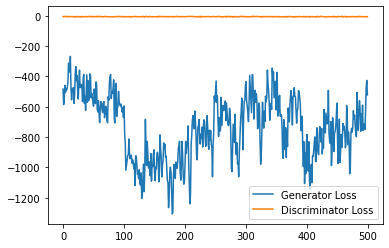

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-10000-epoch-0550.jpg
Epoch [552/925] | Step 10500 | Batch 24/388                   Loss G: -789.4542, loss D: -5.8379
--real images ---


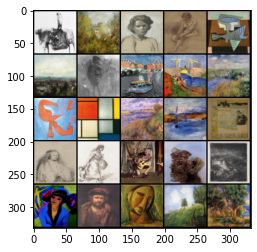

--fake images ---


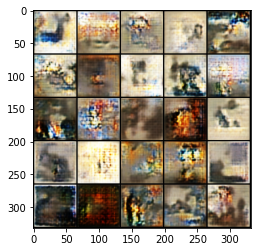

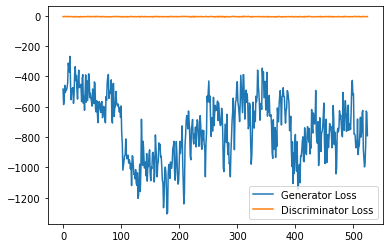

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-10500-epoch-0552.jpg
Epoch [553/925] | Step 11000 | Batch 136/388                   Loss G: -919.0549, loss D: -6.6402
--real images ---


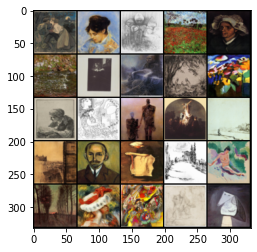

--fake images ---


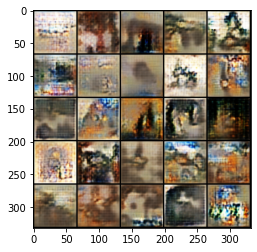

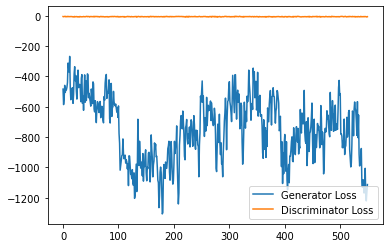

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-11000-epoch-0553.jpg
Epoch [554/925] | Step 11500 | Batch 248/388                   Loss G: -918.3003, loss D: -6.7508
--real images ---


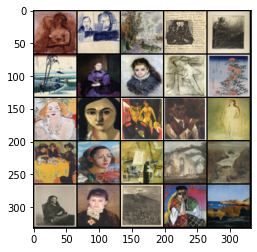

--fake images ---


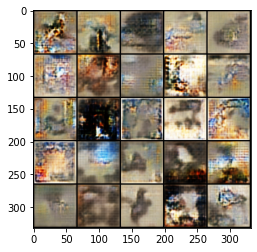

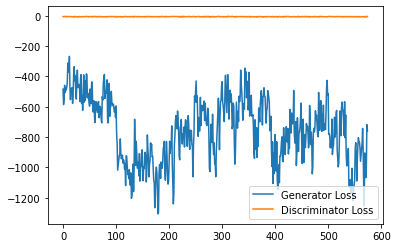

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-11500-epoch-0554.jpg
Epoch [555/925] | Step 12000 | Batch 360/388                   Loss G: -738.8727, loss D: -6.1393
--real images ---


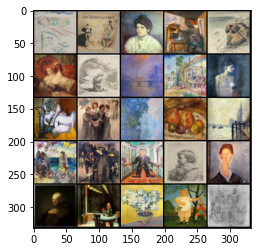

--fake images ---


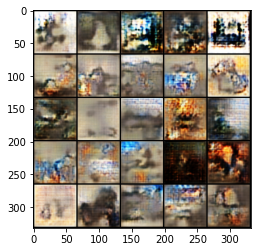

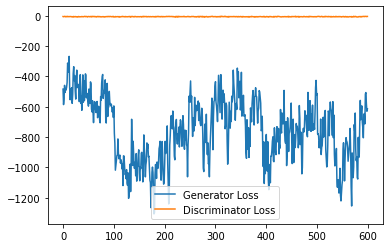

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-12000-epoch-0555.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0555.jpg


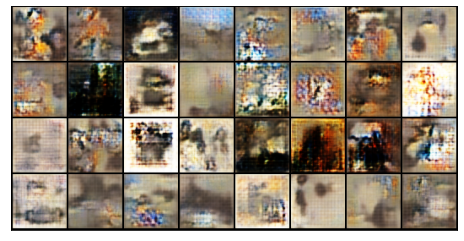

------------------------------------------------------------------------------------
Epoch [557/925] | Step 12500 | Batch 84/388                   Loss G: -595.4506, loss D: -6.1828
--real images ---


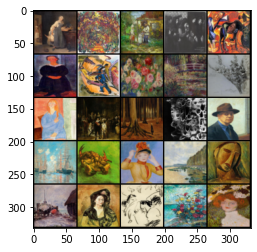

--fake images ---


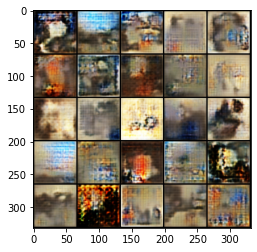

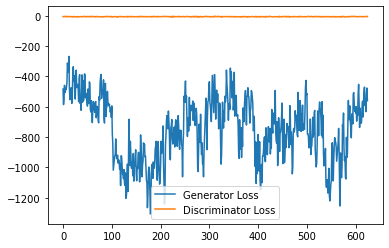

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-12500-epoch-0557.jpg
Epoch [558/925] | Step 13000 | Batch 196/388                   Loss G: -665.0943, loss D: -6.0721
--real images ---


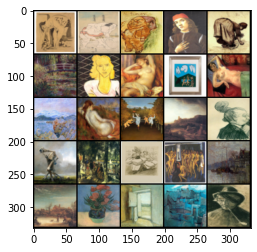

--fake images ---


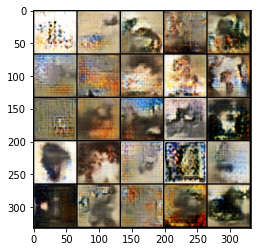

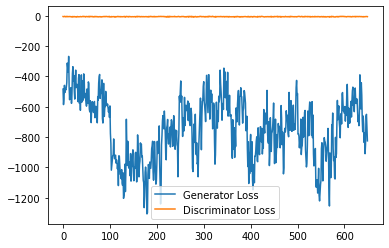

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-13000-epoch-0558.jpg
Epoch [559/925] | Step 13500 | Batch 308/388                   Loss G: -690.0667, loss D: -6.4118
--real images ---


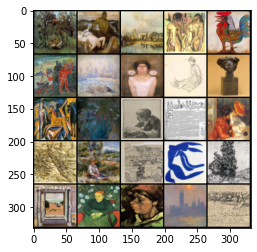

--fake images ---


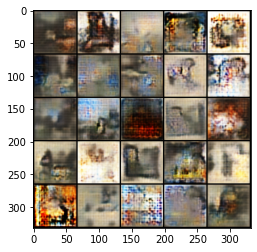

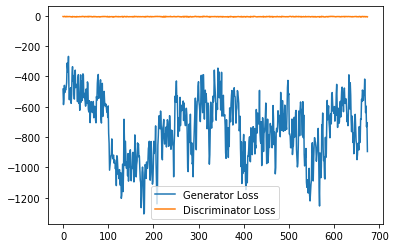

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-13500-epoch-0559.jpg
Epoch [561/925] | Step 14000 | Batch 32/388                   Loss G: -839.8991, loss D: -6.0120
--real images ---


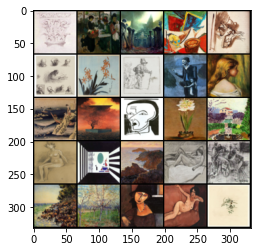

--fake images ---


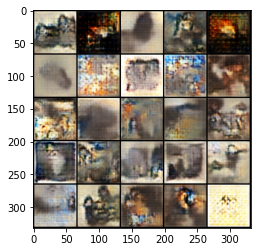

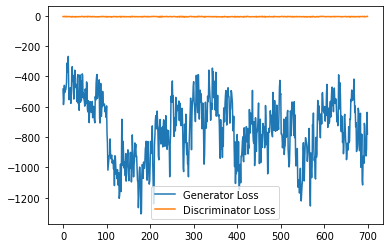

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-14000-epoch-0561.jpg
Epoch [562/925] | Step 14500 | Batch 144/388                   Loss G: -955.5916, loss D: -6.1973
--real images ---


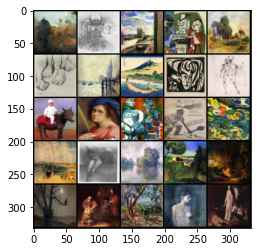

--fake images ---


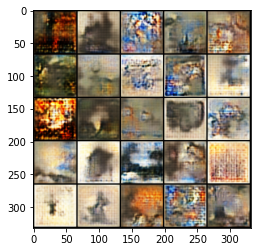

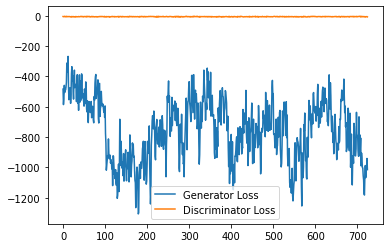

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-14500-epoch-0562.jpg
Epoch [563/925] | Step 15000 | Batch 256/388                   Loss G: -1108.4859, loss D: -6.4904
--real images ---


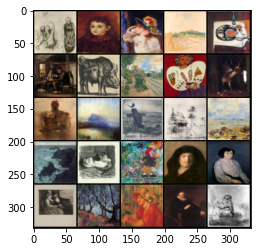

--fake images ---


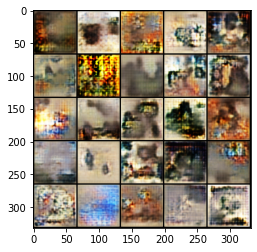

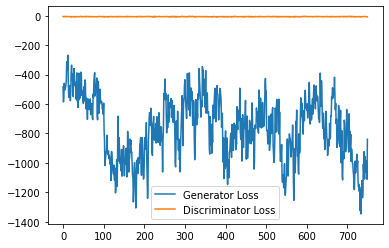

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-15000-epoch-0563.jpg
Epoch [564/925] | Step 15500 | Batch 368/388                   Loss G: -1050.4082, loss D: -5.9480
--real images ---


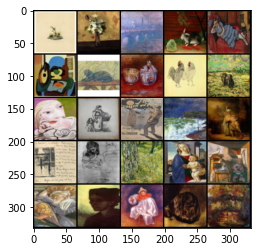

--fake images ---


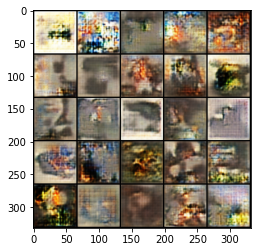

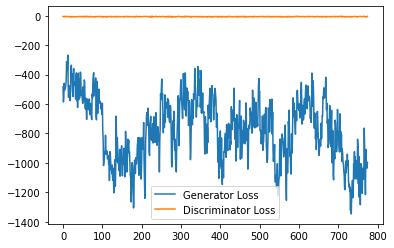

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-15500-epoch-0564.jpg
Epoch [566/925] | Step 16000 | Batch 92/388                   Loss G: -994.5052, loss D: -5.9514
--real images ---


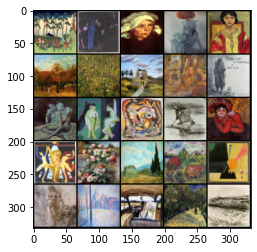

--fake images ---


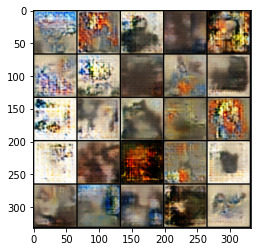

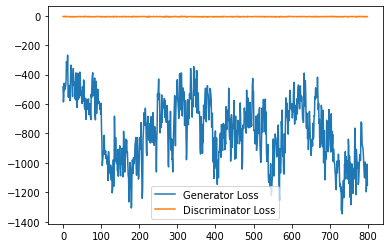

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-16000-epoch-0566.jpg
Epoch [567/925] | Step 16500 | Batch 204/388                   Loss G: -933.0469, loss D: -6.2086
--real images ---


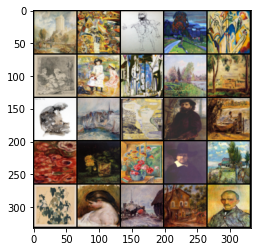

--fake images ---


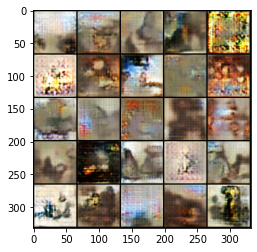

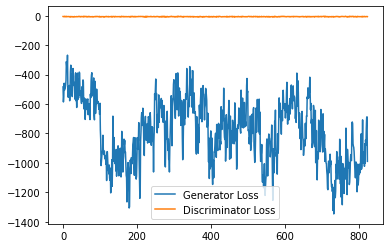

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-16500-epoch-0567.jpg
Epoch [568/925] | Step 17000 | Batch 316/388                   Loss G: -1198.2319, loss D: -6.3202
--real images ---


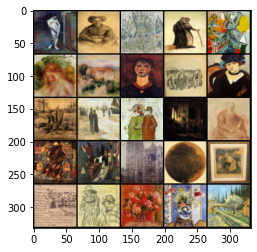

--fake images ---


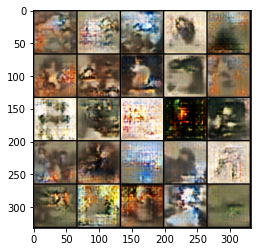

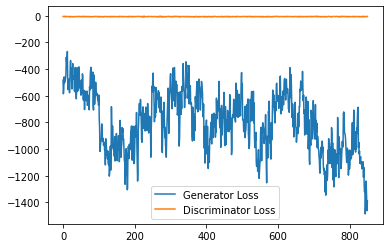

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-17000-epoch-0568.jpg
Epoch [570/925] | Step 17500 | Batch 40/388                   Loss G: -1396.9906, loss D: -6.3939
--real images ---


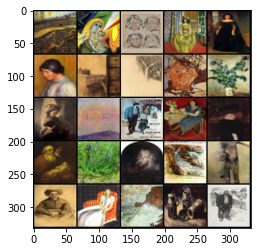

--fake images ---


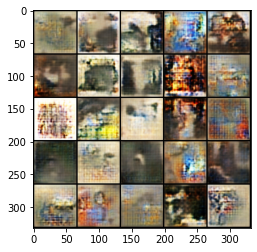

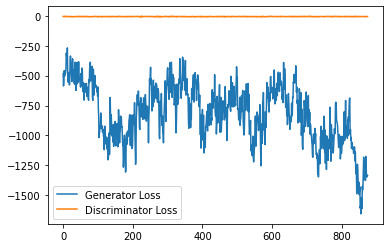

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-17500-epoch-0570.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0570.jpg


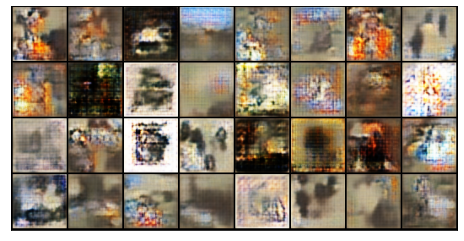

------------------------------------------------------------------------------------
Epoch [571/925] | Step 18000 | Batch 152/388                   Loss G: -1327.9913, loss D: -6.1181
--real images ---


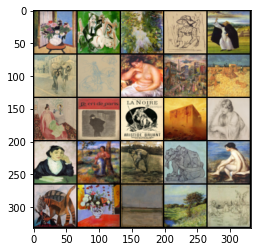

--fake images ---


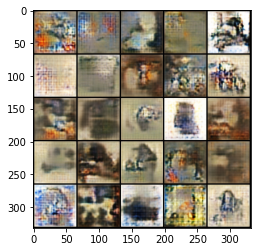

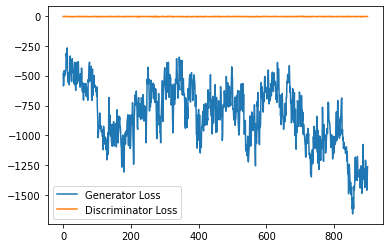

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-18000-epoch-0571.jpg
Epoch [572/925] | Step 18500 | Batch 264/388                   Loss G: -1341.8928, loss D: -6.3079
--real images ---


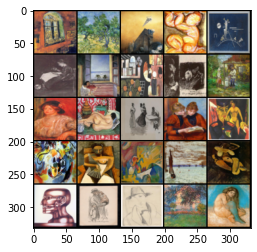

--fake images ---


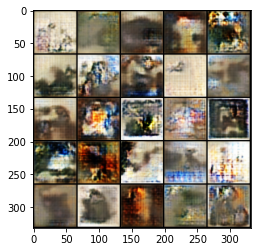

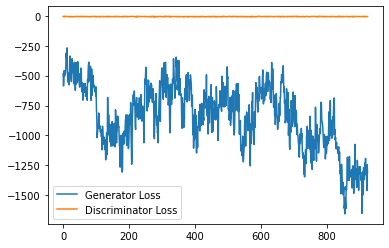

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-18500-epoch-0572.jpg
Epoch [573/925] | Step 19000 | Batch 376/388                   Loss G: -1217.4808, loss D: -5.7775
--real images ---


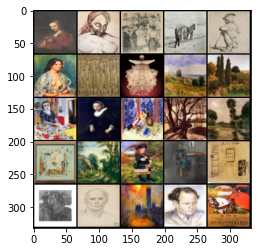

--fake images ---


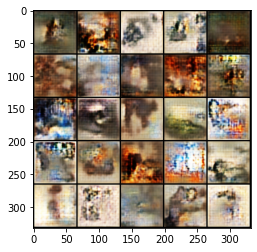

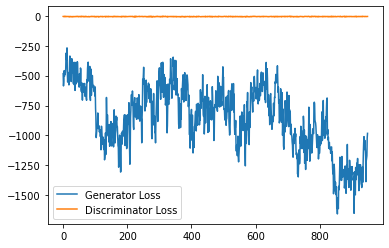

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-19000-epoch-0573.jpg
Epoch [575/925] | Step 19500 | Batch 100/388                   Loss G: -1047.1676, loss D: -6.3070
--real images ---


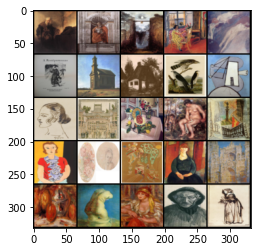

--fake images ---


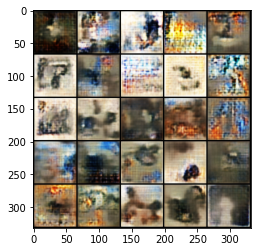

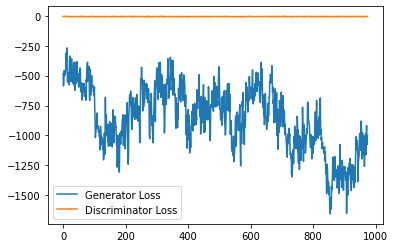

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-19500-epoch-0575.jpg
Epoch [576/925] | Step 20000 | Batch 212/388                   Loss G: -1183.6844, loss D: -6.5426
--real images ---


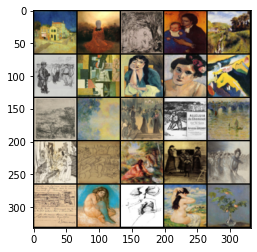

--fake images ---


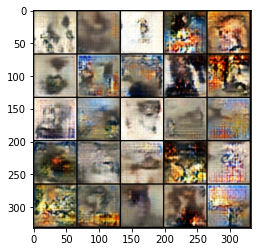

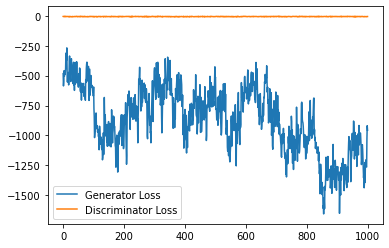

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-20000-epoch-0576.jpg
Epoch [577/925] | Step 20500 | Batch 324/388                   Loss G: -1072.5377, loss D: -6.0790
--real images ---


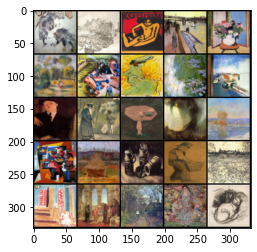

--fake images ---


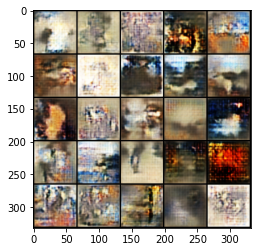

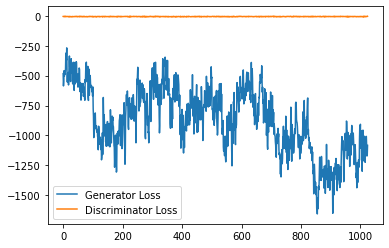

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-20500-epoch-0577.jpg
Epoch [579/925] | Step 21000 | Batch 48/388                   Loss G: -944.6624, loss D: -6.5649
--real images ---


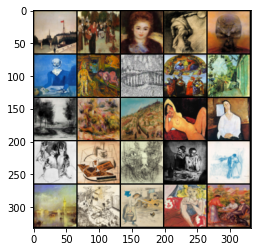

--fake images ---


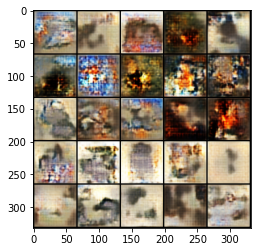

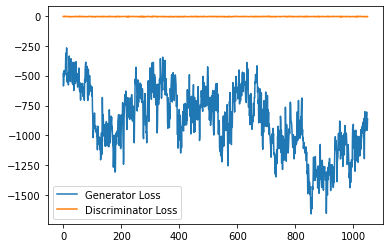

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-21000-epoch-0579.jpg
Epoch [580/925] | Step 21500 | Batch 160/388                   Loss G: -1088.4973, loss D: -6.2760
--real images ---


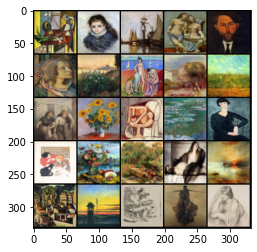

--fake images ---


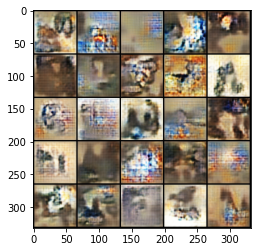

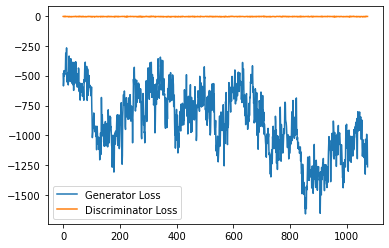

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-21500-epoch-0580.jpg
Epoch [581/925] | Step 22000 | Batch 272/388                   Loss G: -1170.5844, loss D: -6.3865
--real images ---


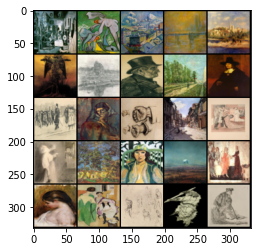

--fake images ---


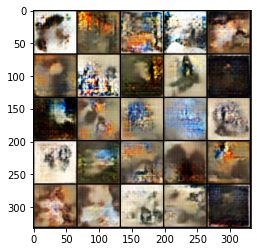

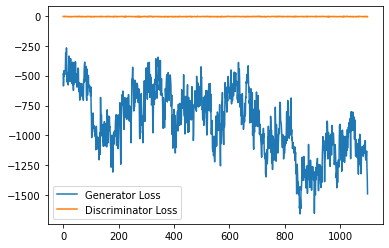

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-22000-epoch-0581.jpg
Epoch [582/925] | Step 22500 | Batch 384/388                   Loss G: -1355.7115, loss D: -6.1718
--real images ---


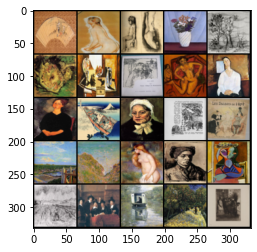

--fake images ---


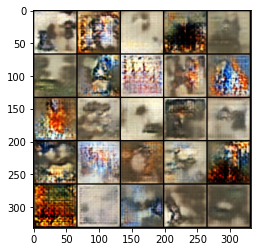

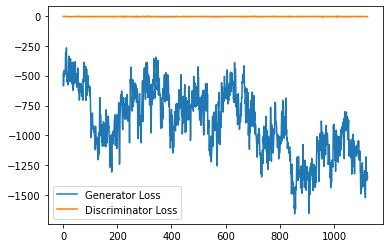

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-22500-epoch-0582.jpg
Epoch [584/925] | Step 23000 | Batch 108/388                   Loss G: -1017.6185, loss D: -6.4408
--real images ---


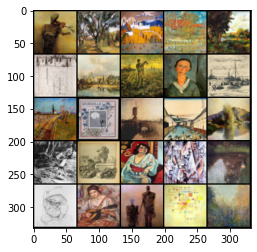

--fake images ---


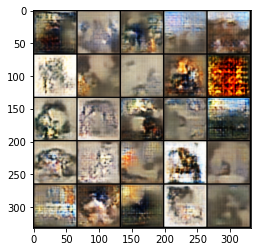

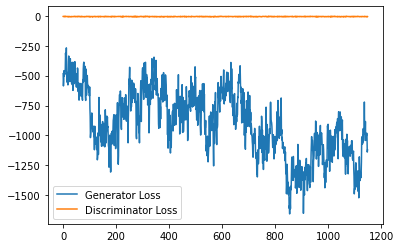

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-23000-epoch-0584.jpg
Epoch [585/925] | Step 23500 | Batch 220/388                   Loss G: -1290.4632, loss D: -6.1384
--real images ---


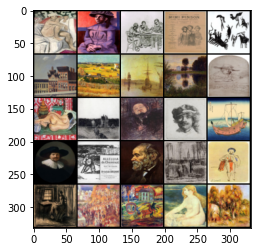

--fake images ---


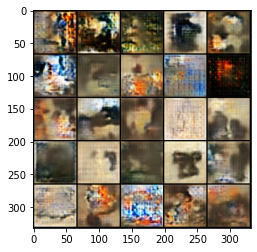

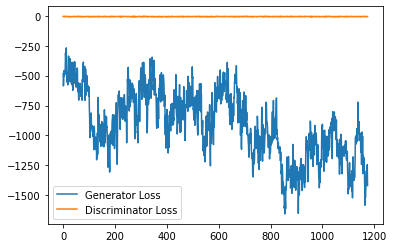

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-23500-epoch-0585.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0585.jpg


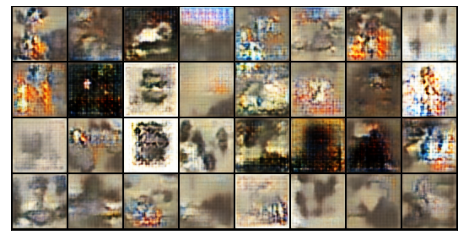

------------------------------------------------------------------------------------
Epoch [586/925] | Step 24000 | Batch 332/388                   Loss G: -1440.6979, loss D: -6.3432
--real images ---


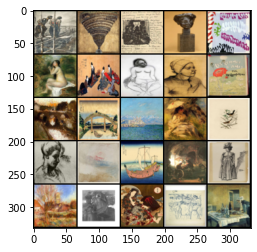

--fake images ---


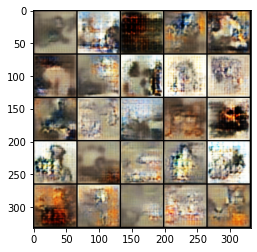

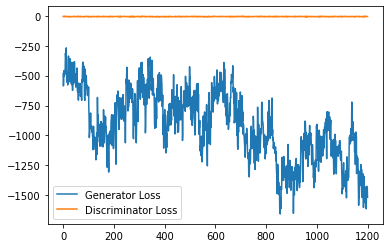

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-24000-epoch-0586.jpg
Epoch [588/925] | Step 24500 | Batch 56/388                   Loss G: -1378.6437, loss D: -6.4107
--real images ---


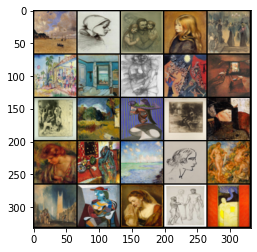

--fake images ---


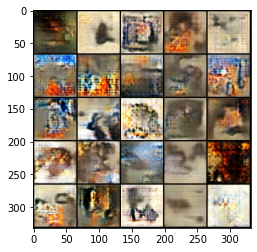

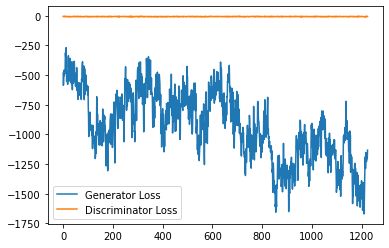

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-24500-epoch-0588.jpg
Epoch [589/925] | Step 25000 | Batch 168/388                   Loss G: -1031.7163, loss D: -5.9419
--real images ---


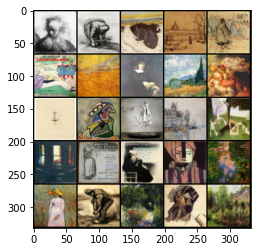

--fake images ---


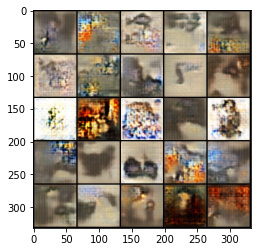

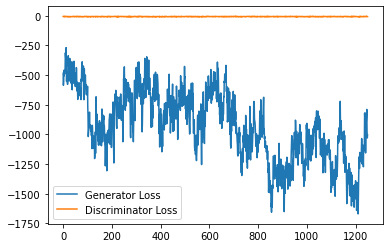

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-25000-epoch-0589.jpg
Epoch [590/925] | Step 25500 | Batch 280/388                   Loss G: -911.2494, loss D: -5.7359
--real images ---


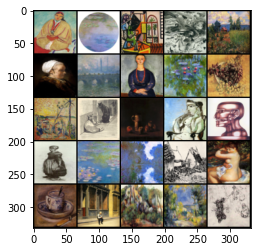

--fake images ---


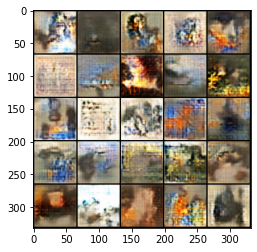

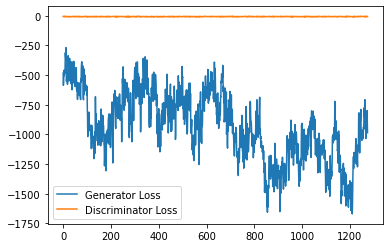

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-25500-epoch-0590.jpg
Epoch [592/925] | Step 26000 | Batch 4/388                   Loss G: -893.6039, loss D: -6.6306
--real images ---


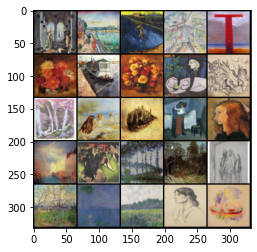

--fake images ---


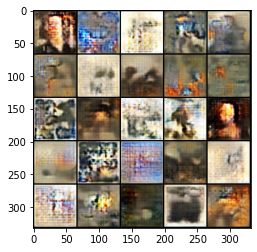

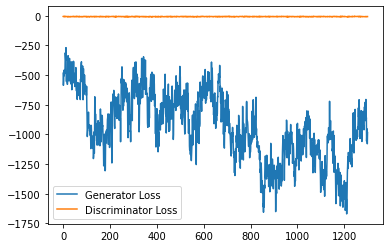

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-26000-epoch-0592.jpg
Epoch [593/925] | Step 26500 | Batch 116/388                   Loss G: -1120.4278, loss D: -6.3889
--real images ---


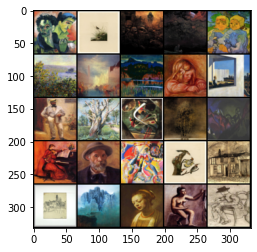

--fake images ---


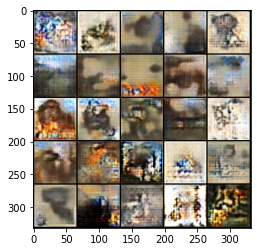

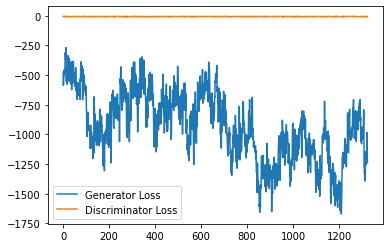

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-26500-epoch-0593.jpg
Epoch [594/925] | Step 27000 | Batch 228/388                   Loss G: -900.8446, loss D: -6.0192
--real images ---


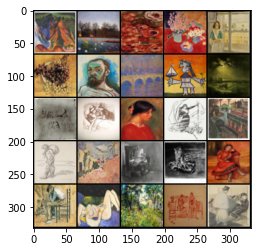

--fake images ---


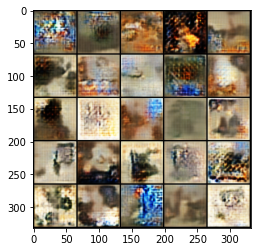

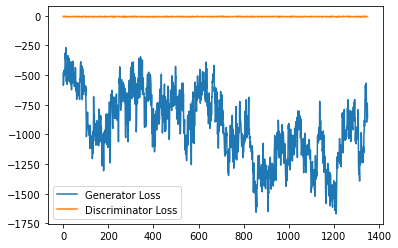

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-27000-epoch-0594.jpg
Epoch [595/925] | Step 27500 | Batch 340/388                   Loss G: -833.0602, loss D: -6.0959
--real images ---


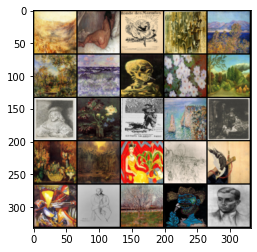

--fake images ---


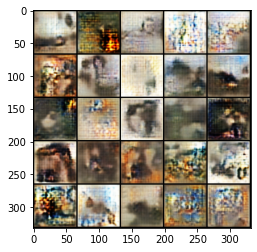

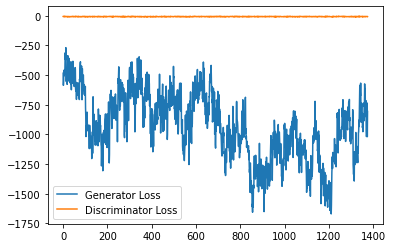

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-27500-epoch-0595.jpg
Epoch [597/925] | Step 28000 | Batch 64/388                   Loss G: -754.6729, loss D: -6.4886
--real images ---


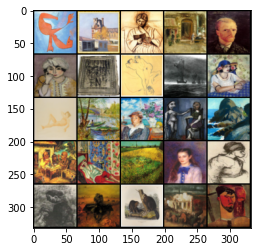

--fake images ---


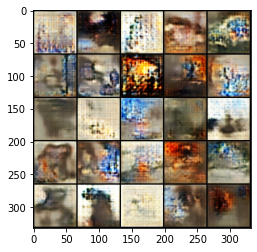

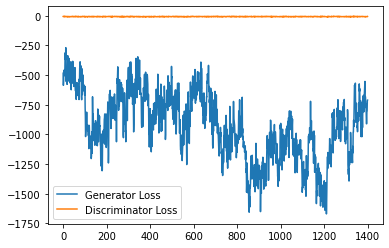

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-28000-epoch-0597.jpg
Epoch [598/925] | Step 28500 | Batch 176/388                   Loss G: -779.2451, loss D: -6.7512
--real images ---


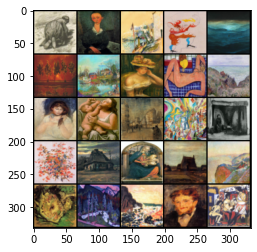

--fake images ---


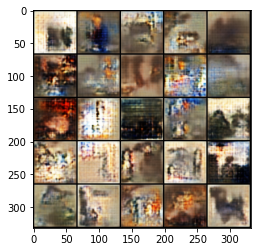

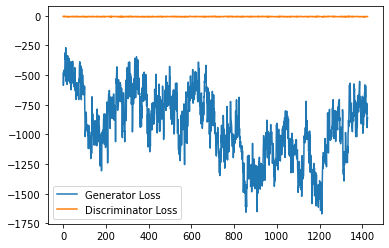

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-28500-epoch-0598.jpg
Epoch [599/925] | Step 29000 | Batch 288/388                   Loss G: -821.7788, loss D: -6.2576
--real images ---


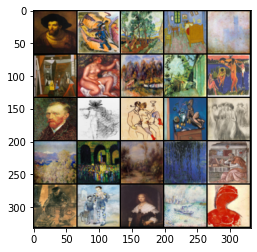

--fake images ---


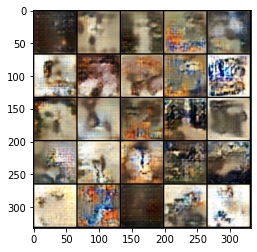

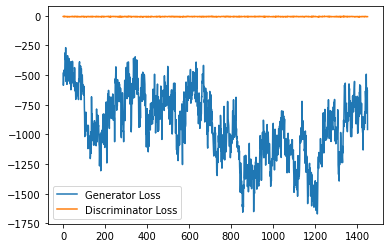

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-29000-epoch-0599.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0600.jpg


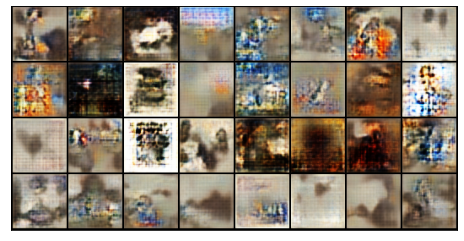

------------------------------------------------------------------------------------
Epoch [601/925] | Step 29500 | Batch 12/388                   Loss G: -966.1021, loss D: -6.3873
--real images ---


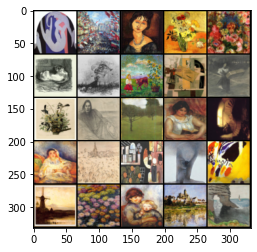

--fake images ---


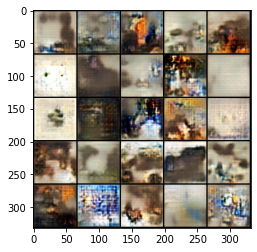

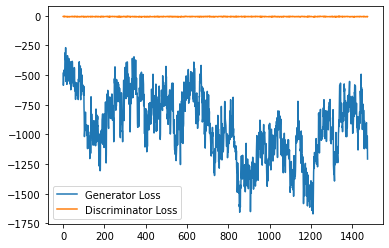

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-29500-epoch-0601.jpg
Epoch [602/925] | Step 30000 | Batch 124/388                   Loss G: -1152.3525, loss D: -6.0840
--real images ---


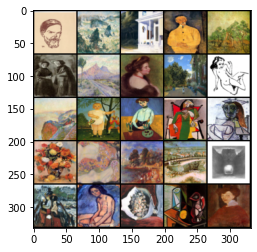

--fake images ---


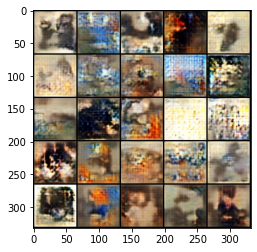

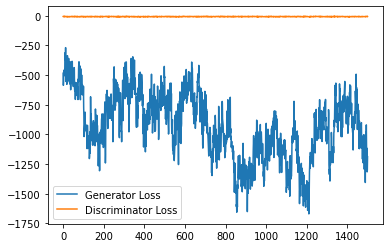

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-30000-epoch-0602.jpg
Epoch [603/925] | Step 30500 | Batch 236/388                   Loss G: -1223.9464, loss D: -6.3539
--real images ---


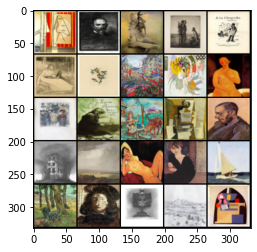

--fake images ---


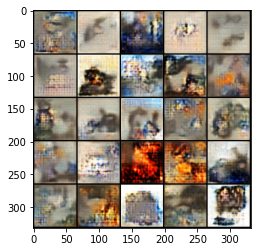

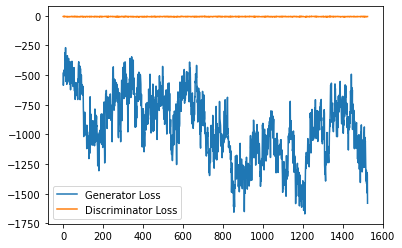

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-30500-epoch-0603.jpg
Epoch [604/925] | Step 31000 | Batch 348/388                   Loss G: -1349.2196, loss D: -6.4339
--real images ---


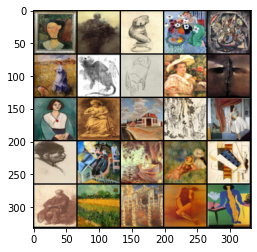

--fake images ---


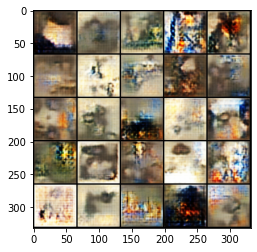

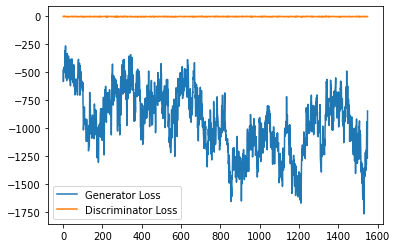

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-31000-epoch-0604.jpg
Epoch [606/925] | Step 31500 | Batch 72/388                   Loss G: -1010.3416, loss D: -6.3348
--real images ---


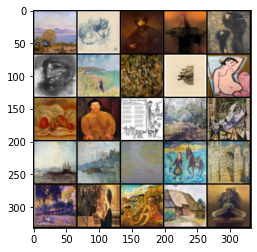

--fake images ---


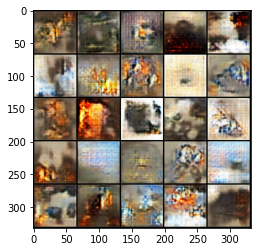

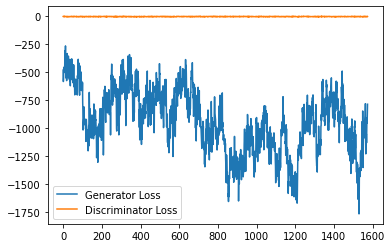

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-31500-epoch-0606.jpg
Epoch [607/925] | Step 32000 | Batch 184/388                   Loss G: -935.7464, loss D: -6.4827
--real images ---


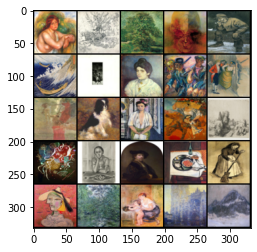

--fake images ---


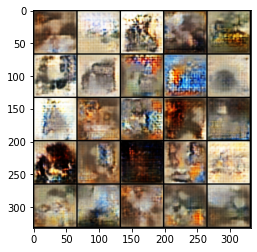

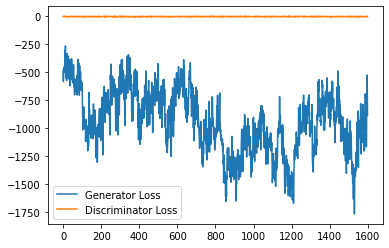

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-32000-epoch-0607.jpg
Epoch [608/925] | Step 32500 | Batch 296/388                   Loss G: -1031.3765, loss D: -6.3754
--real images ---


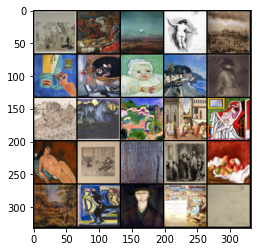

--fake images ---


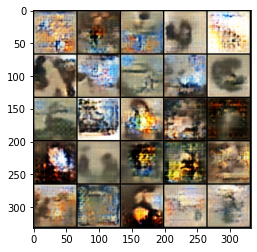

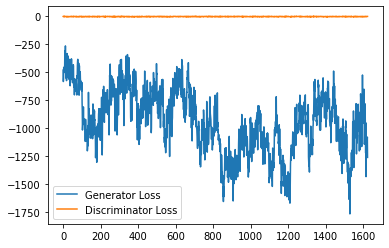

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-32500-epoch-0608.jpg
Epoch [610/925] | Step 33000 | Batch 20/388                   Loss G: -1033.0195, loss D: -6.6890
--real images ---


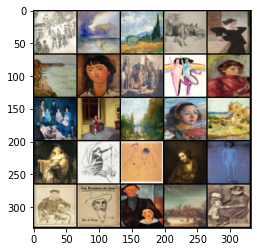

--fake images ---


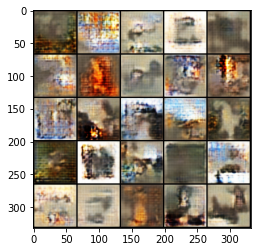

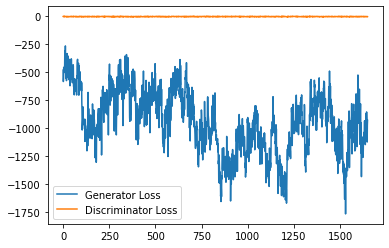

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-33000-epoch-0610.jpg
Epoch [611/925] | Step 33500 | Batch 132/388                   Loss G: -972.4078, loss D: -6.4686
--real images ---


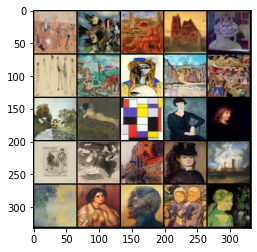

--fake images ---


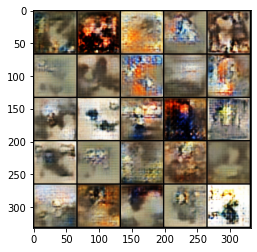

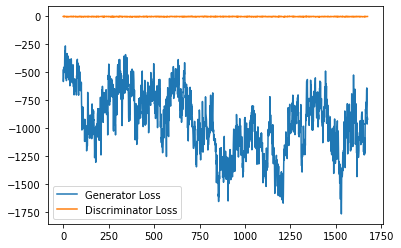

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-33500-epoch-0611.jpg
Epoch [612/925] | Step 34000 | Batch 244/388                   Loss G: -951.6974, loss D: -6.6229
--real images ---


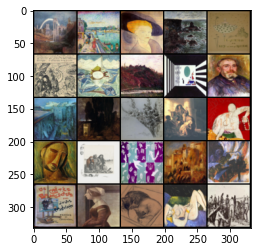

--fake images ---


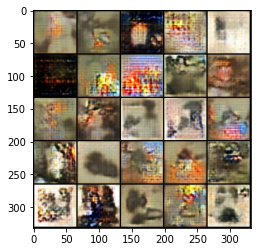

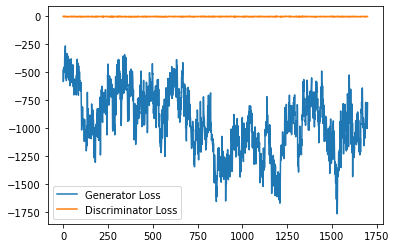

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-34000-epoch-0612.jpg
Epoch [613/925] | Step 34500 | Batch 356/388                   Loss G: -1030.8676, loss D: -6.4474
--real images ---


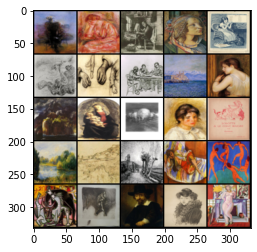

--fake images ---


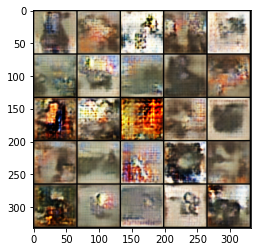

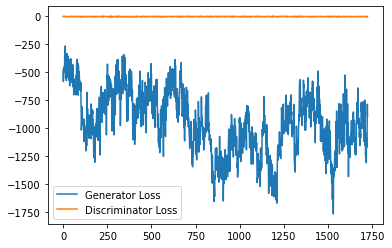

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-34500-epoch-0613.jpg
Epoch [615/925] | Step 35000 | Batch 80/388                   Loss G: -797.3884, loss D: -6.6886
--real images ---


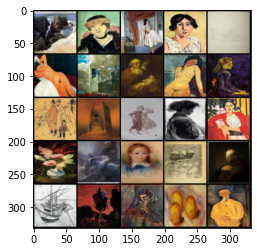

--fake images ---


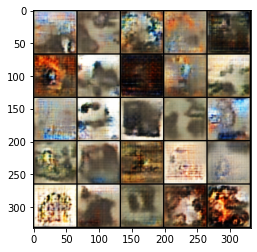

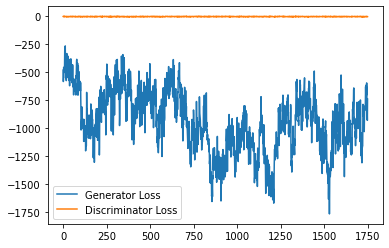

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-35000-epoch-0615.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0615.jpg


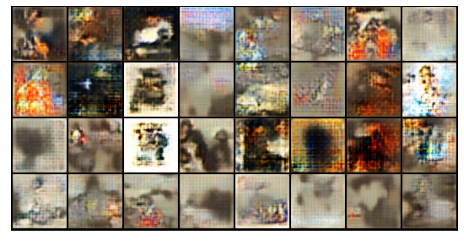

------------------------------------------------------------------------------------
Epoch [616/925] | Step 35500 | Batch 192/388                   Loss G: -784.2903, loss D: -6.5882
--real images ---


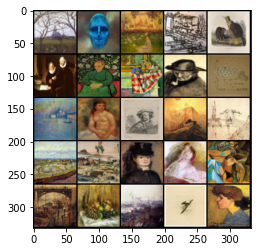

--fake images ---


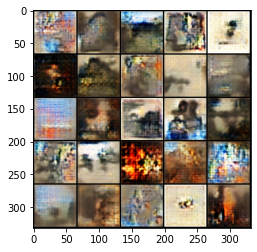

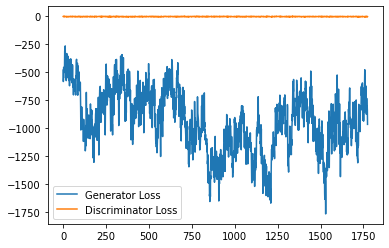

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-35500-epoch-0616.jpg
Epoch [617/925] | Step 36000 | Batch 304/388                   Loss G: -729.2712, loss D: -6.5660
--real images ---


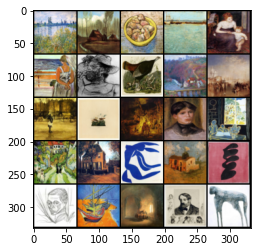

--fake images ---


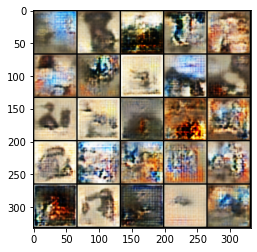

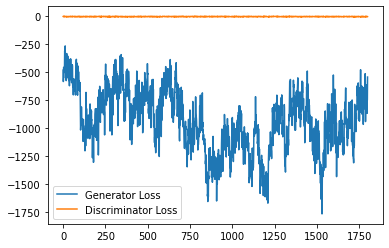

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-36000-epoch-0617.jpg
Epoch [619/925] | Step 36500 | Batch 28/388                   Loss G: -665.1696, loss D: -6.2239
--real images ---


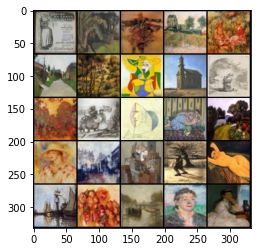

--fake images ---


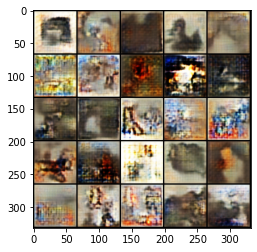

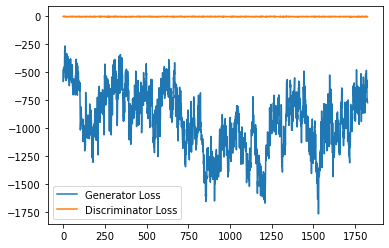

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-36500-epoch-0619.jpg
Epoch [620/925] | Step 37000 | Batch 140/388                   Loss G: -718.3994, loss D: -6.2505
--real images ---


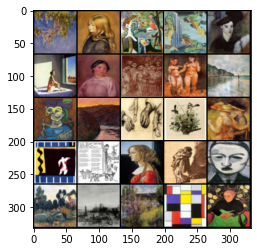

--fake images ---


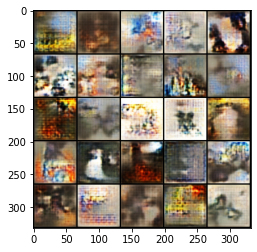

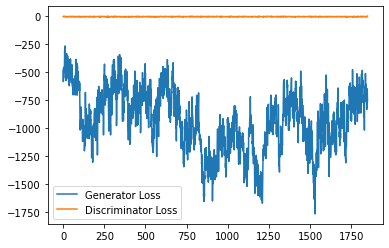

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-37000-epoch-0620.jpg
Epoch [621/925] | Step 37500 | Batch 252/388                   Loss G: -812.7679, loss D: -6.0589
--real images ---


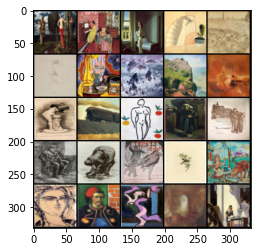

--fake images ---


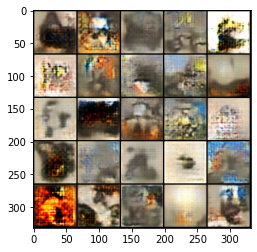

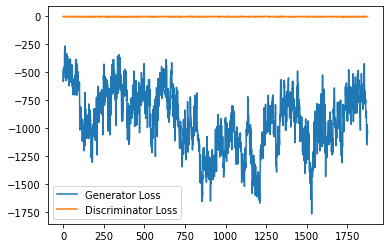

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-37500-epoch-0621.jpg
Epoch [622/925] | Step 38000 | Batch 364/388                   Loss G: -901.3670, loss D: -6.2866
--real images ---


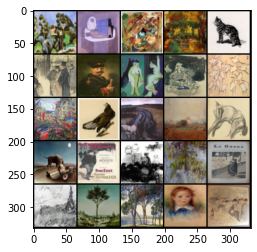

--fake images ---


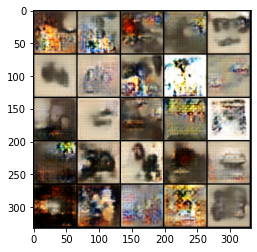

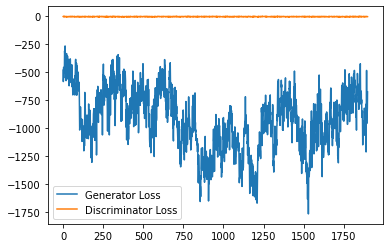

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-38000-epoch-0622.jpg
Epoch [624/925] | Step 38500 | Batch 88/388                   Loss G: -822.8890, loss D: -6.6099
--real images ---


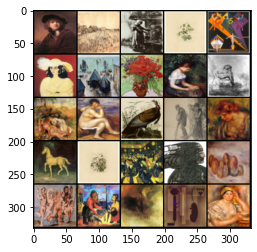

--fake images ---


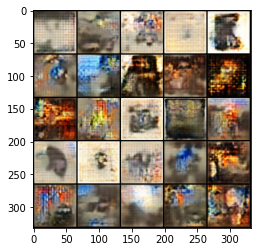

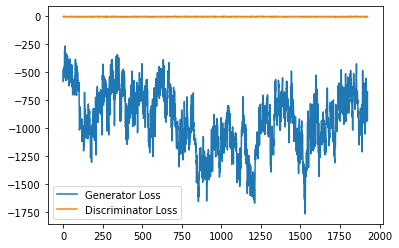

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-38500-epoch-0624.jpg
Epoch [625/925] | Step 39000 | Batch 200/388                   Loss G: -892.7303, loss D: -6.1684
--real images ---


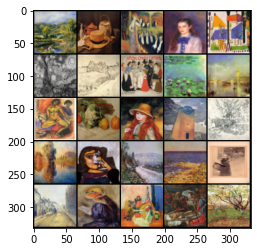

--fake images ---


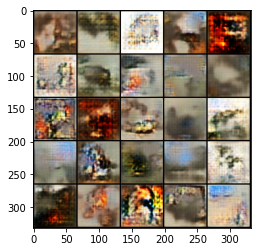

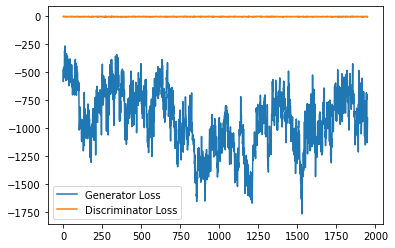

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-39000-epoch-0625.jpg
Epoch [626/925] | Step 39500 | Batch 312/388                   Loss G: -826.6845, loss D: -6.1896
--real images ---


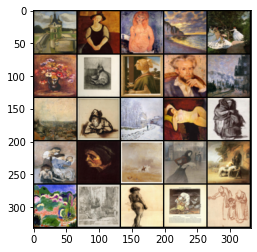

--fake images ---


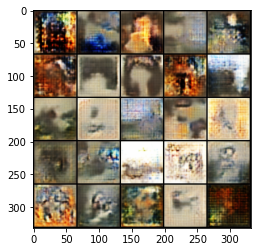

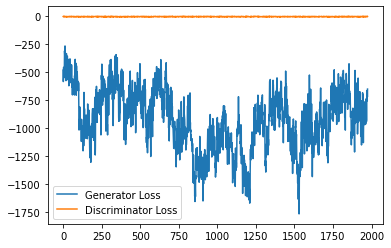

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-39500-epoch-0626.jpg
Epoch [628/925] | Step 40000 | Batch 36/388                   Loss G: -834.3881, loss D: -6.4335
--real images ---


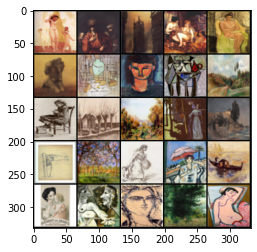

--fake images ---


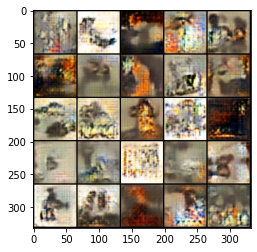

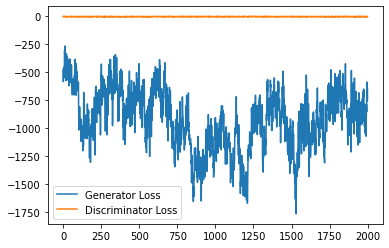

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-40000-epoch-0628.jpg
Epoch [629/925] | Step 40500 | Batch 148/388                   Loss G: -548.5382, loss D: -5.8641
--real images ---


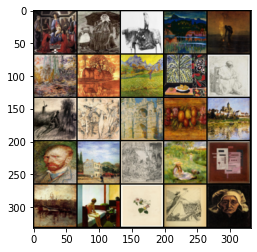

--fake images ---


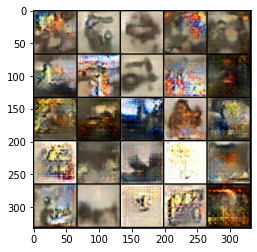

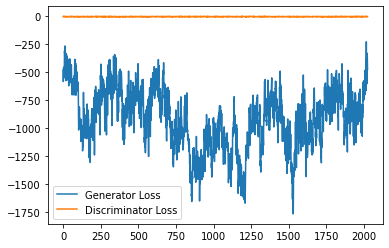

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-40500-epoch-0629.jpg
Epoch [630/925] | Step 41000 | Batch 260/388                   Loss G: -909.6095, loss D: -5.9317
--real images ---


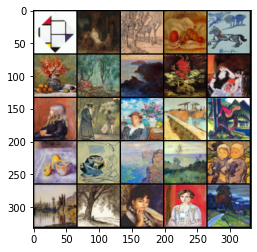

--fake images ---


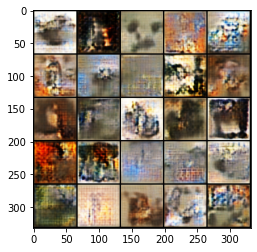

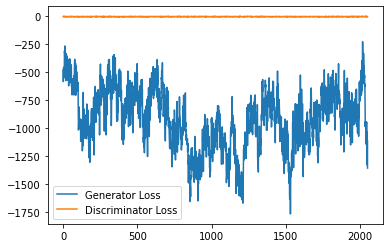

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-41000-epoch-0630.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0630.jpg


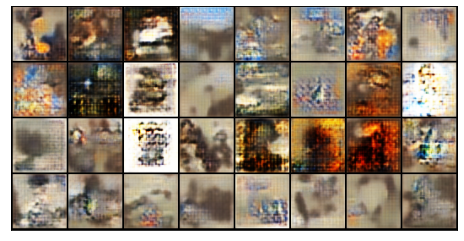

------------------------------------------------------------------------------------
Epoch [631/925] | Step 41500 | Batch 372/388                   Loss G: -1223.2244, loss D: -6.4911
--real images ---


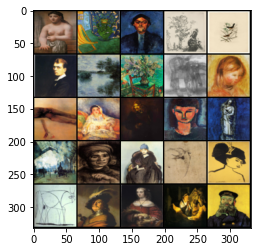

--fake images ---


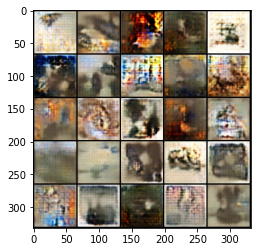

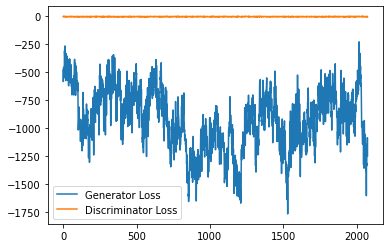

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-41500-epoch-0631.jpg
Epoch [633/925] | Step 42000 | Batch 96/388                   Loss G: -1326.0007, loss D: -6.6077
--real images ---


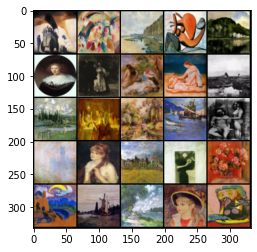

--fake images ---


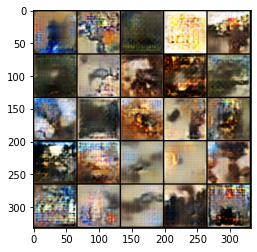

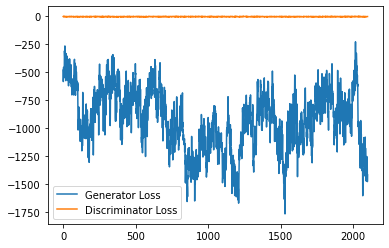

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-42000-epoch-0633.jpg
Epoch [634/925] | Step 42500 | Batch 208/388                   Loss G: -1408.6190, loss D: -6.4023
--real images ---


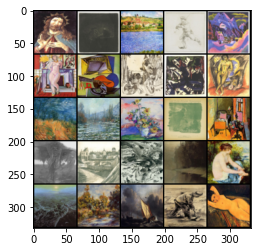

--fake images ---


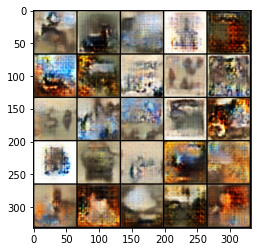

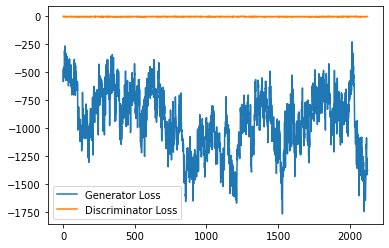

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-42500-epoch-0634.jpg
Epoch [635/925] | Step 43000 | Batch 320/388                   Loss G: -1238.4354, loss D: -6.5566
--real images ---


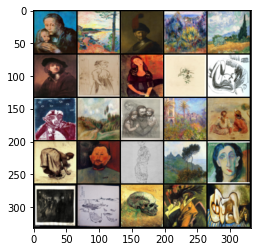

--fake images ---


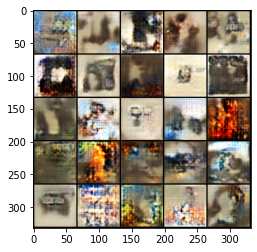

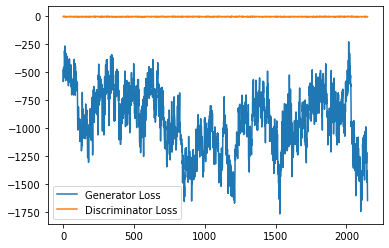

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-43000-epoch-0635.jpg
Epoch [637/925] | Step 43500 | Batch 44/388                   Loss G: -1254.5773, loss D: -5.9554
--real images ---


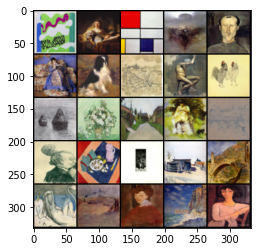

--fake images ---


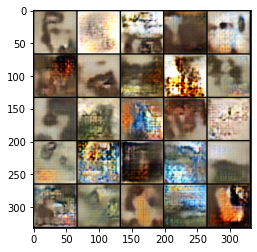

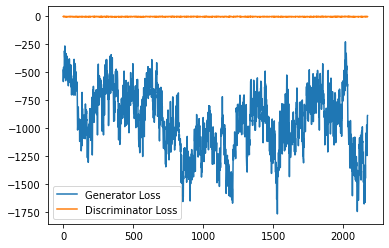

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-43500-epoch-0637.jpg
Epoch [638/925] | Step 44000 | Batch 156/388                   Loss G: -1257.2780, loss D: -6.1561
--real images ---


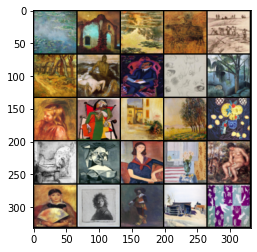

--fake images ---


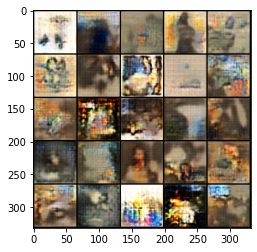

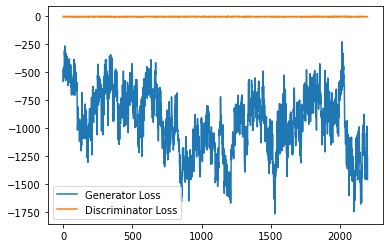

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-44000-epoch-0638.jpg
Epoch [639/925] | Step 44500 | Batch 268/388                   Loss G: -1243.2507, loss D: -6.3017
--real images ---


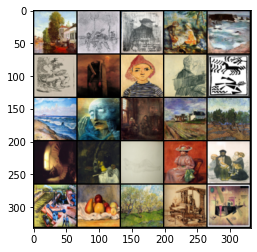

--fake images ---


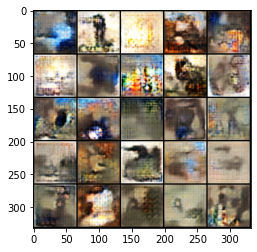

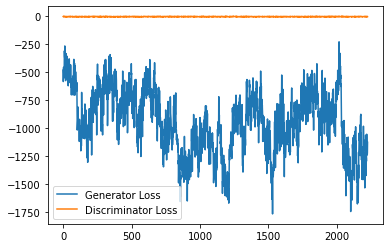

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-44500-epoch-0639.jpg
Epoch [640/925] | Step 45000 | Batch 380/388                   Loss G: -1205.1485, loss D: -6.4327
--real images ---


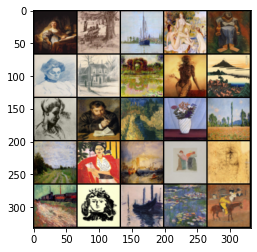

--fake images ---


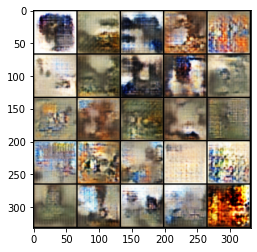

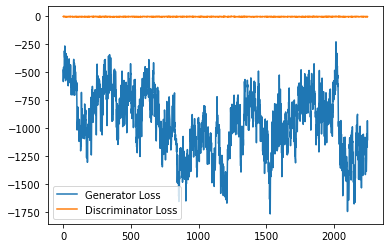

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-45000-epoch-0640.jpg
Epoch [642/925] | Step 45500 | Batch 104/388                   Loss G: -1048.8593, loss D: -6.2610
--real images ---


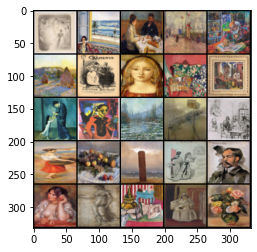

--fake images ---


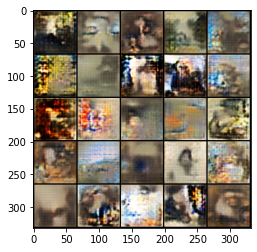

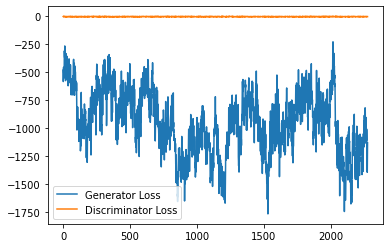

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-45500-epoch-0642.jpg
Epoch [643/925] | Step 46000 | Batch 216/388                   Loss G: -1201.1433, loss D: -6.2676
--real images ---


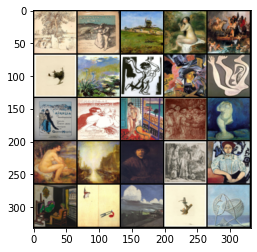

--fake images ---


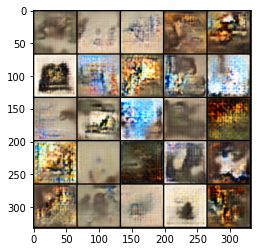

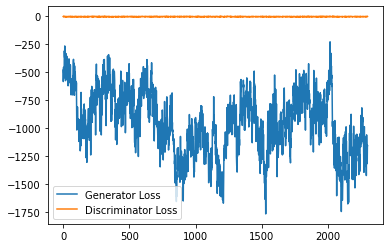

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-46000-epoch-0643.jpg
Epoch [644/925] | Step 46500 | Batch 328/388                   Loss G: -1017.5516, loss D: -6.4642
--real images ---


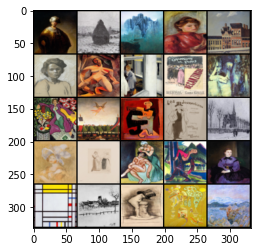

--fake images ---


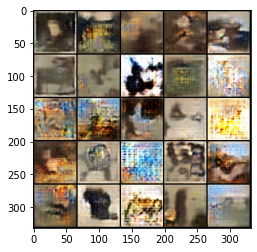

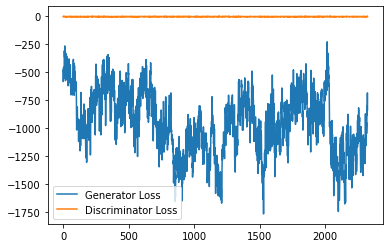

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-46500-epoch-0644.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0645.jpg


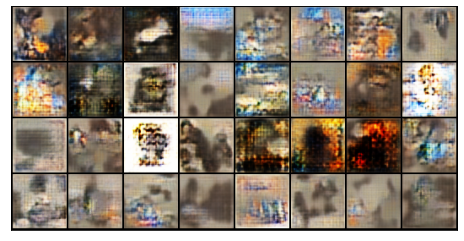

------------------------------------------------------------------------------------
Epoch [646/925] | Step 47000 | Batch 52/388                   Loss G: -896.7345, loss D: -6.2345
--real images ---


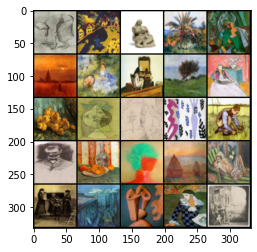

--fake images ---


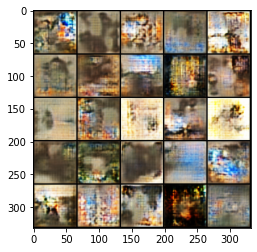

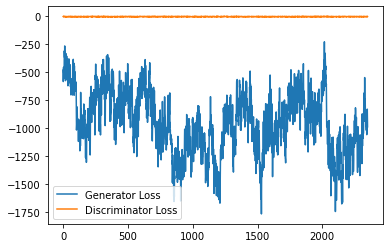

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-47000-epoch-0646.jpg
Epoch [647/925] | Step 47500 | Batch 164/388                   Loss G: -992.6153, loss D: -6.0229
--real images ---


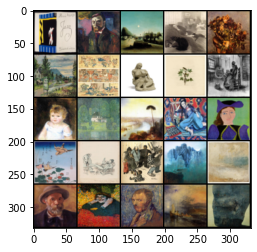

--fake images ---


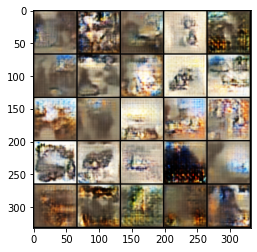

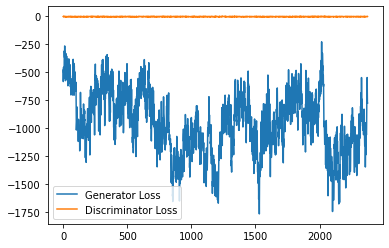

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-47500-epoch-0647.jpg
Epoch [648/925] | Step 48000 | Batch 276/388                   Loss G: -804.3657, loss D: -6.0060
--real images ---


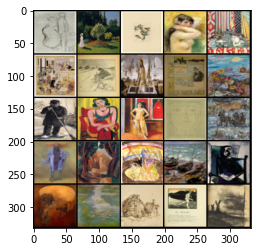

--fake images ---


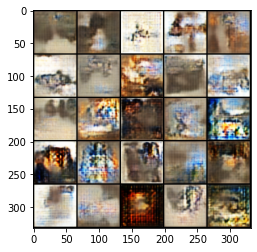

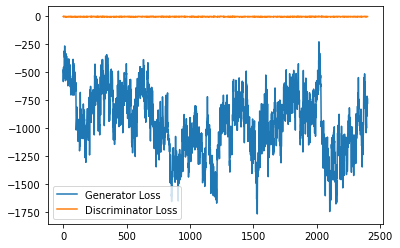

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-48000-epoch-0648.jpg
Epoch [650/925] | Step 48500 | Batch 0/388                   Loss G: -910.2882, loss D: -5.8829
--real images ---


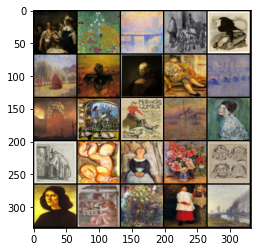

--fake images ---


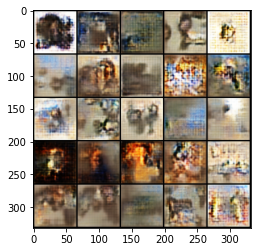

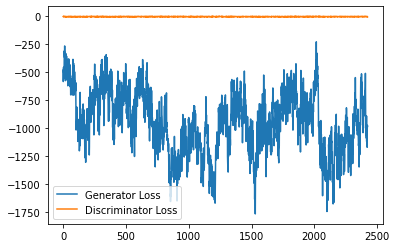

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-48500-epoch-0650.jpg
Epoch [651/925] | Step 49000 | Batch 112/388                   Loss G: -1017.3972, loss D: -6.3531
--real images ---


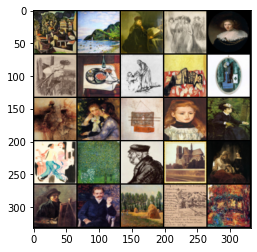

--fake images ---


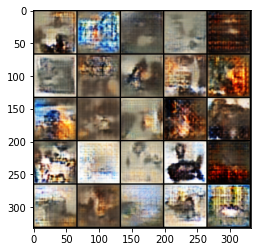

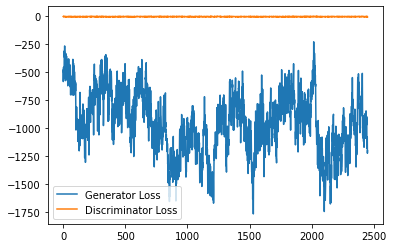

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-49000-epoch-0651.jpg
Epoch [652/925] | Step 49500 | Batch 224/388                   Loss G: -1007.5933, loss D: -6.2900
--real images ---


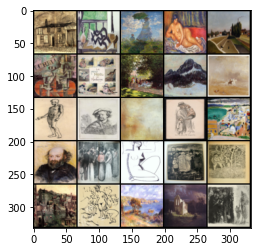

--fake images ---


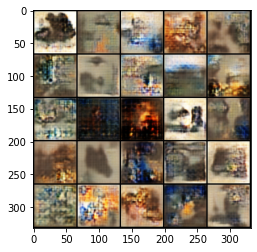

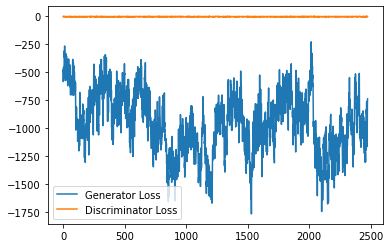

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-49500-epoch-0652.jpg
Epoch [653/925] | Step 50000 | Batch 336/388                   Loss G: -733.2265, loss D: -5.9101
--real images ---


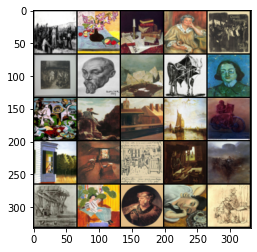

--fake images ---


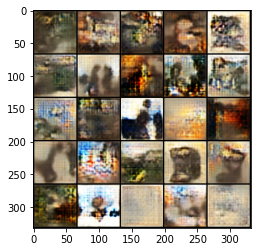

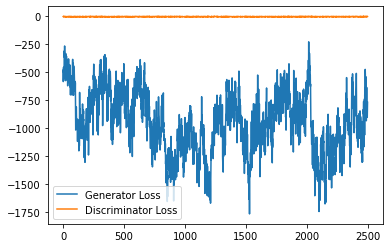

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-50000-epoch-0653.jpg
Epoch [655/925] | Step 50500 | Batch 60/388                   Loss G: -883.1954, loss D: -6.1935
--real images ---


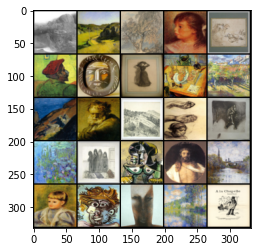

--fake images ---


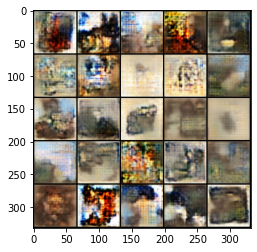

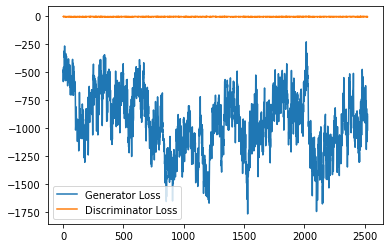

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-50500-epoch-0655.jpg
Epoch [656/925] | Step 51000 | Batch 172/388                   Loss G: -974.3553, loss D: -5.9112
--real images ---


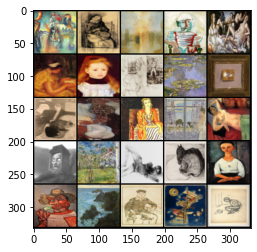

--fake images ---


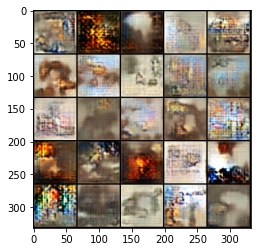

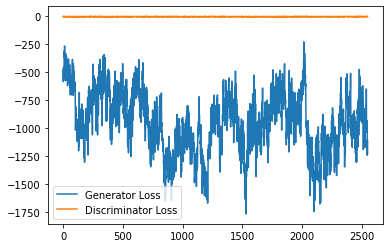

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-51000-epoch-0656.jpg
Epoch [657/925] | Step 51500 | Batch 284/388                   Loss G: -1173.3127, loss D: -6.1432
--real images ---


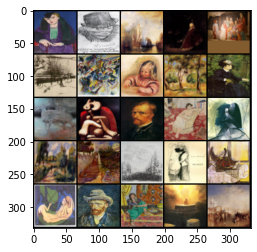

--fake images ---


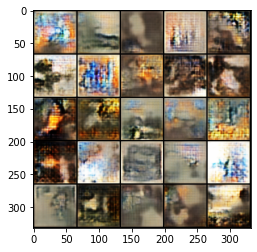

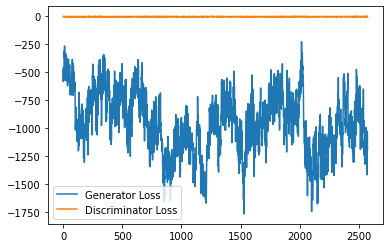

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-51500-epoch-0657.jpg
Epoch [659/925] | Step 52000 | Batch 8/388                   Loss G: -1046.0884, loss D: -6.6894
--real images ---


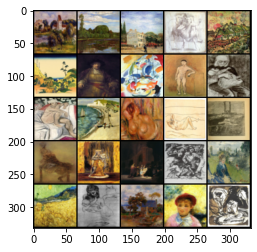

--fake images ---


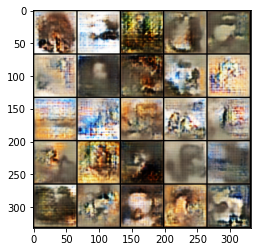

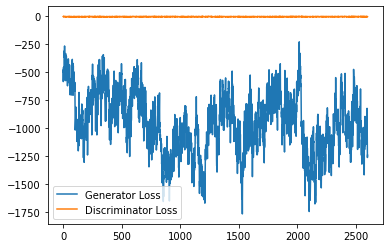

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-52000-epoch-0659.jpg
Epoch [660/925] | Step 52500 | Batch 120/388                   Loss G: -1058.1229, loss D: -6.2619
--real images ---


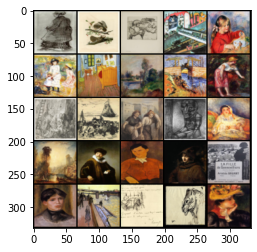

--fake images ---


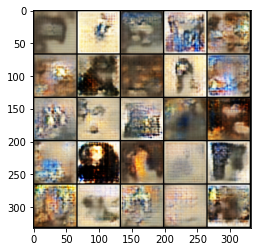

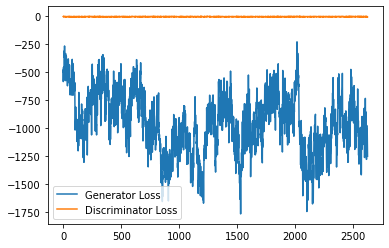

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-52500-epoch-0660.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0660.jpg


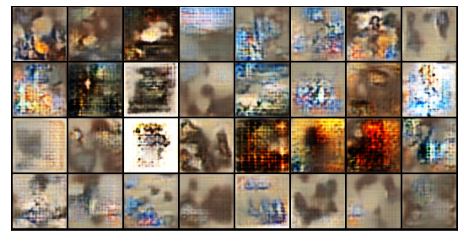

------------------------------------------------------------------------------------
Epoch [661/925] | Step 53000 | Batch 232/388                   Loss G: -1131.5604, loss D: -6.2075
--real images ---


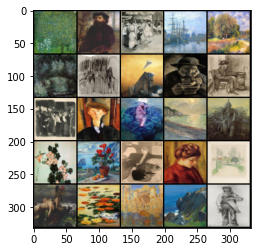

--fake images ---


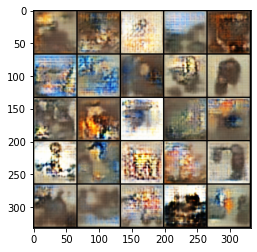

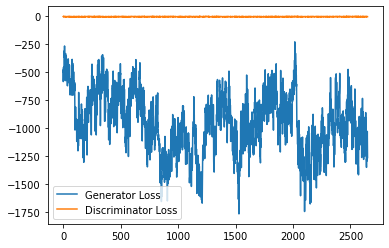

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-53000-epoch-0661.jpg
Epoch [662/925] | Step 53500 | Batch 344/388                   Loss G: -1271.1304, loss D: -6.3838
--real images ---


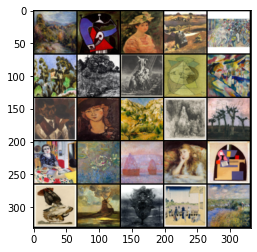

--fake images ---


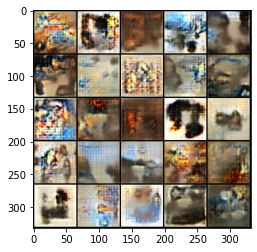

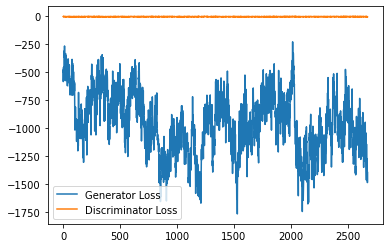

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-53500-epoch-0662.jpg
Epoch [664/925] | Step 54000 | Batch 68/388                   Loss G: -1311.7146, loss D: -5.8577
--real images ---


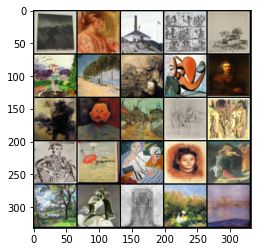

--fake images ---


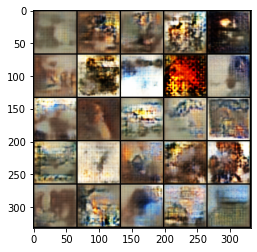

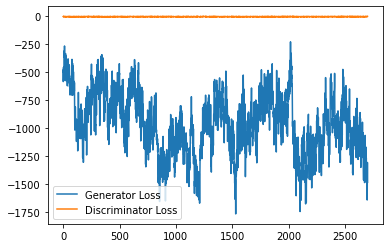

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-54000-epoch-0664.jpg
Epoch [665/925] | Step 54500 | Batch 180/388                   Loss G: -1323.6457, loss D: -5.8322
--real images ---


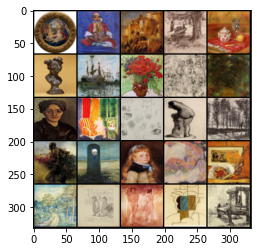

--fake images ---


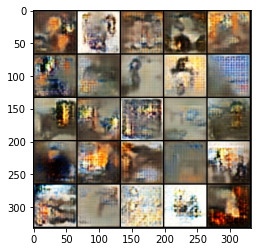

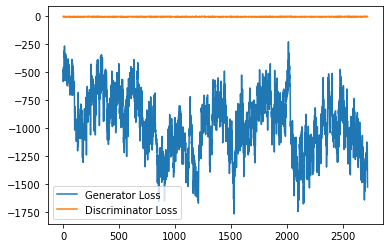

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-54500-epoch-0665.jpg
Epoch [666/925] | Step 55000 | Batch 292/388                   Loss G: -1364.4096, loss D: -6.0204
--real images ---


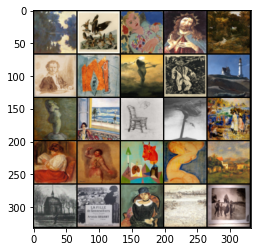

--fake images ---


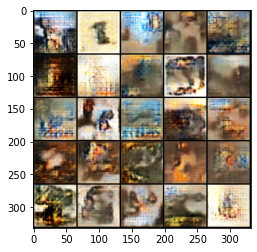

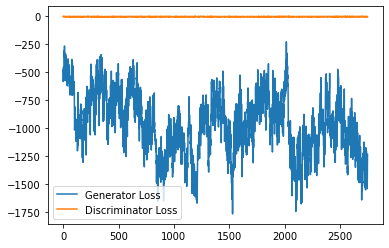

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-55000-epoch-0666.jpg
Epoch [668/925] | Step 55500 | Batch 16/388                   Loss G: -1077.5954, loss D: -5.8369
--real images ---


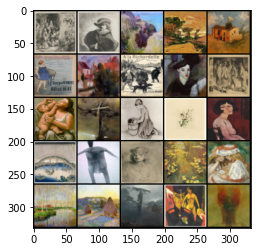

--fake images ---


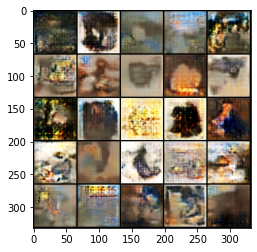

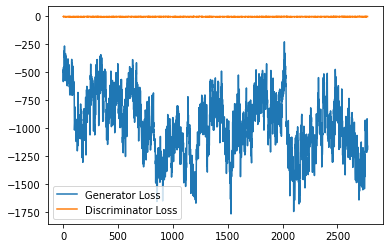

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-55500-epoch-0668.jpg
Epoch [669/925] | Step 56000 | Batch 128/388                   Loss G: -1055.0154, loss D: -6.0713
--real images ---


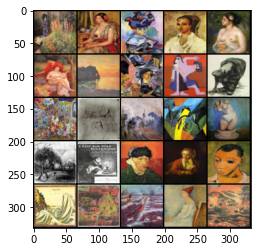

--fake images ---


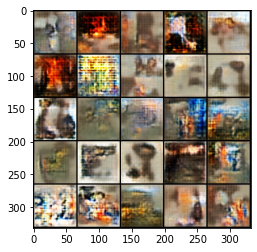

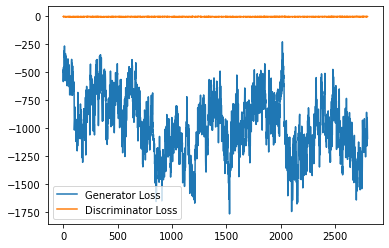

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-56000-epoch-0669.jpg
Epoch [670/925] | Step 56500 | Batch 240/388                   Loss G: -983.0164, loss D: -5.4043
--real images ---


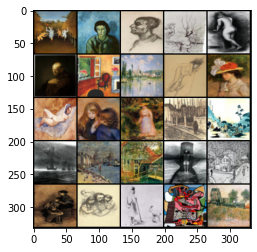

--fake images ---


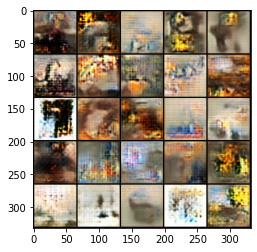

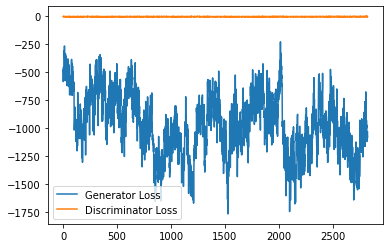

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-56500-epoch-0670.jpg
Epoch [671/925] | Step 57000 | Batch 352/388                   Loss G: -962.4522, loss D: -5.5861
--real images ---


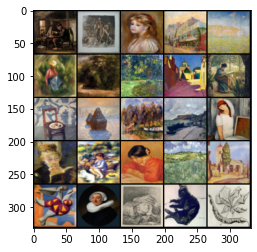

--fake images ---


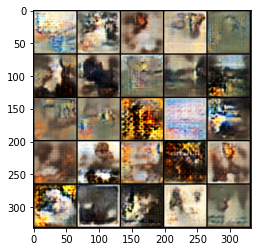

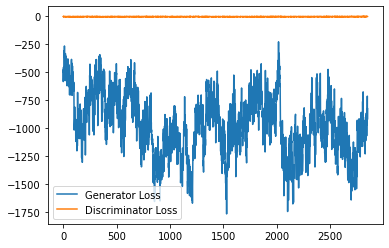

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-57000-epoch-0671.jpg
Epoch [673/925] | Step 57500 | Batch 76/388                   Loss G: -1014.8863, loss D: -5.4550
--real images ---


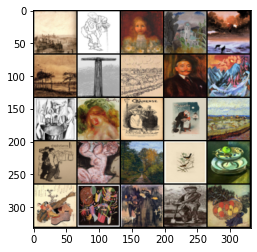

--fake images ---


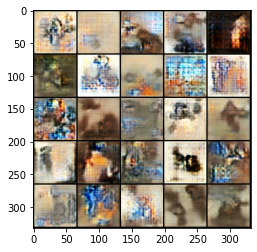

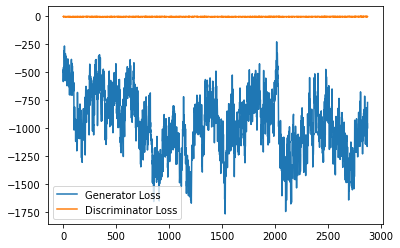

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-57500-epoch-0673.jpg
Epoch [674/925] | Step 58000 | Batch 188/388                   Loss G: -815.2516, loss D: -5.7068
--real images ---


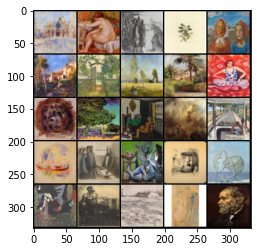

--fake images ---


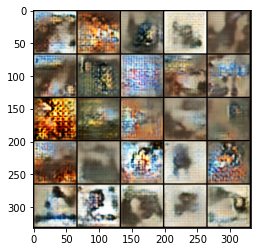

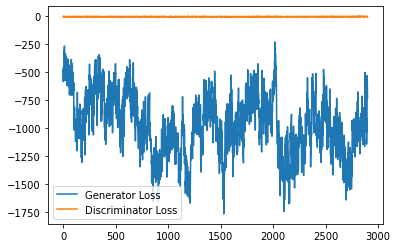

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-58000-epoch-0674.jpg
Epoch [675/925] | Step 58500 | Batch 300/388                   Loss G: -642.0877, loss D: -6.0240
--real images ---


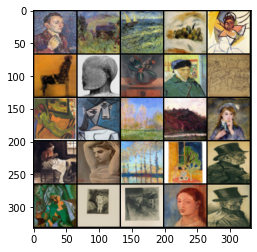

--fake images ---


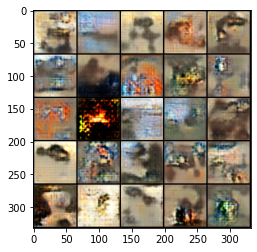

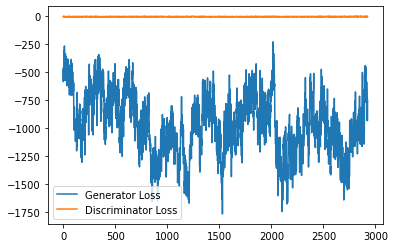

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-58500-epoch-0675.jpg
Saving Wcgan-byartist-generated-images-00388-epoch-0675.jpg


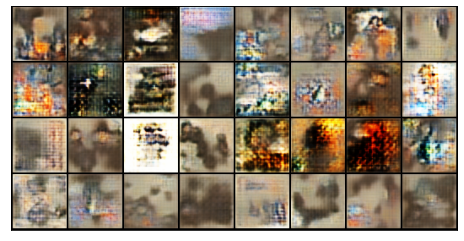

------------------------------------------------------------------------------------
Epoch [677/925] | Step 59000 | Batch 24/388                   Loss G: -749.1065, loss D: -5.6467
--real images ---


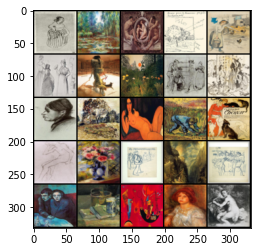

--fake images ---


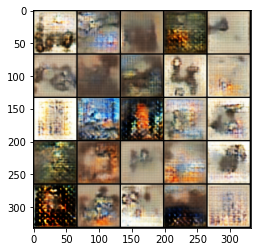

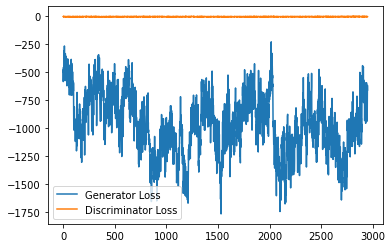

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-59000-epoch-0677.jpg
Epoch [678/925] | Step 59500 | Batch 136/388                   Loss G: -521.8655, loss D: -5.9662
--real images ---


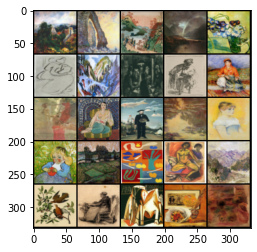

--fake images ---


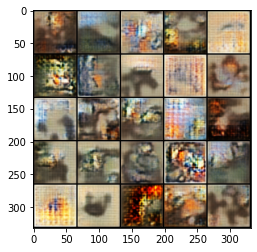

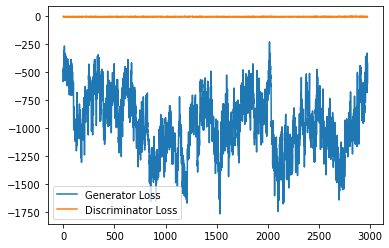

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-59500-epoch-0678.jpg
Epoch [679/925] | Step 60000 | Batch 248/388                   Loss G: -628.2599, loss D: -6.4377
--real images ---


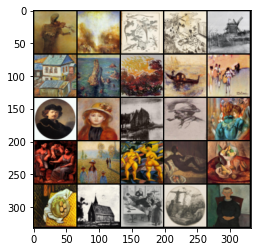

--fake images ---


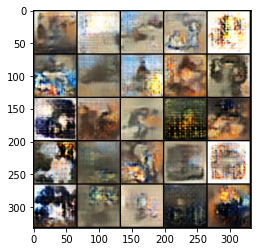

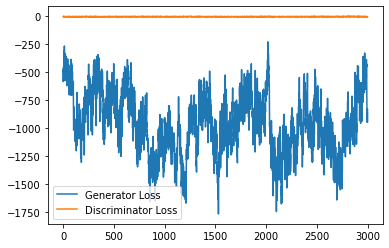

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-60000-epoch-0679.jpg
Epoch [680/925] | Step 60500 | Batch 360/388                   Loss G: -870.0727, loss D: -6.0214
--real images ---


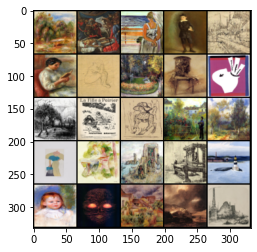

--fake images ---


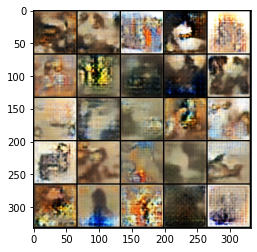

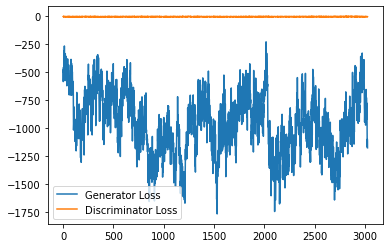

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-60500-epoch-0680.jpg
Epoch [682/925] | Step 61000 | Batch 84/388                   Loss G: -1297.8040, loss D: -6.3233
--real images ---


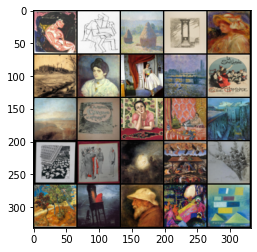

--fake images ---


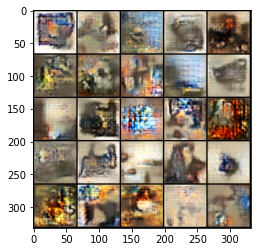

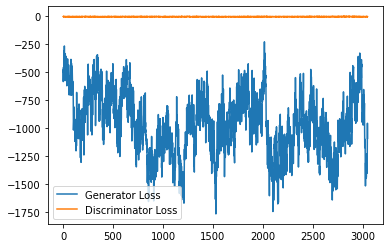

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-61000-epoch-0682.jpg
Epoch [683/925] | Step 61500 | Batch 196/388                   Loss G: -1279.4036, loss D: -6.1531
--real images ---


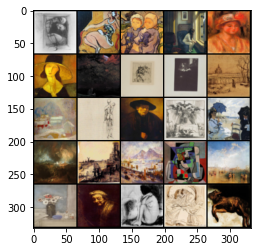

--fake images ---


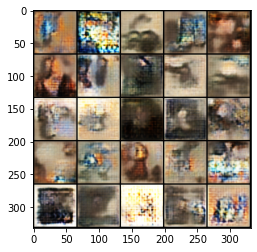

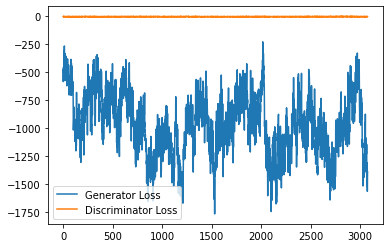

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-61500-epoch-0683.jpg
Epoch [684/925] | Step 62000 | Batch 308/388                   Loss G: -1375.9635, loss D: -5.5067
--real images ---


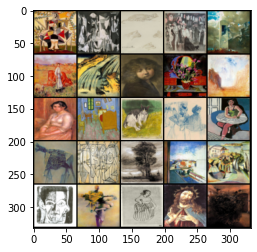

--fake images ---


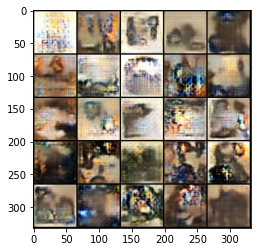

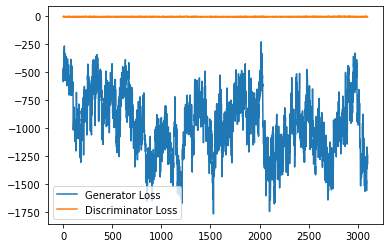

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-62000-epoch-0684.jpg
Epoch [686/925] | Step 62500 | Batch 32/388                   Loss G: -1133.0324, loss D: -6.2308
--real images ---


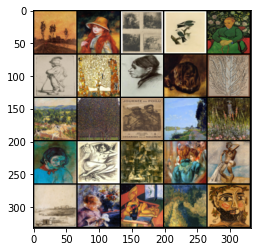

--fake images ---


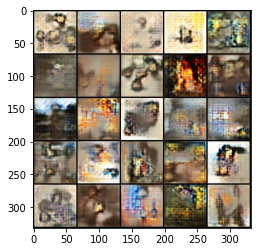

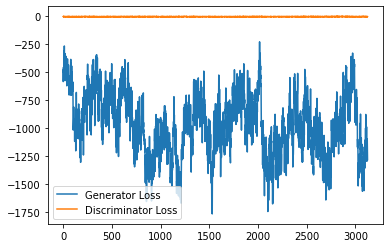

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-62500-epoch-0686.jpg
Epoch [687/925] | Step 63000 | Batch 144/388                   Loss G: -1072.0383, loss D: -5.8351
--real images ---


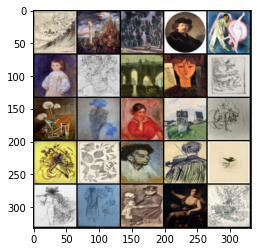

--fake images ---


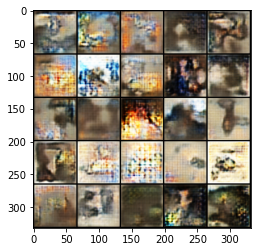

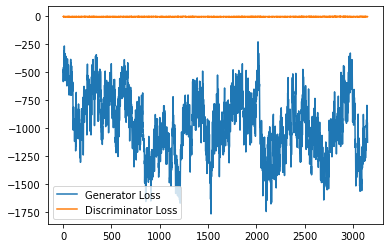

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-63000-epoch-0687.jpg
Epoch [688/925] | Step 63500 | Batch 256/388                   Loss G: -1067.1129, loss D: -6.0487
--real images ---


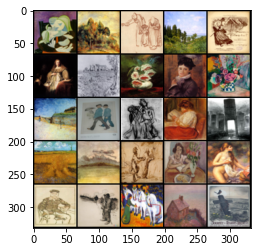

--fake images ---


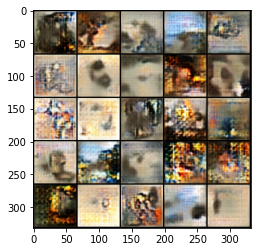

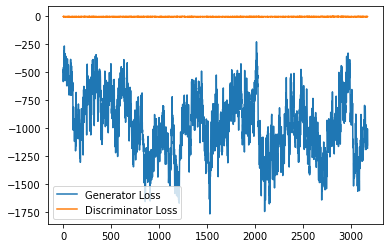

saving images generated with fixed noise
Saving Wcgan-byartist-generated-images-63500-epoch-0688.jpg


In [ ]:
# # --- Mnist 
# dataset = datasets.MNIST(root="dataset/", transform=transformations, download=True)
# loader = DataLoader(
#     dataset,
#     batch_size=BATCH_SIZE,
#     shuffle=True,
# )

# initialize gen and disc, note: discriminator should be called critic,
# according to WGAN paper (since it no longer outputs between [0, 1])
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN, NUM_CLASSES, IMG_SIZE, GENERATOR_EMBEDDING).to(device)
critic = Discriminator(CHANNELS_IMG, FEATURES_CRITIC, NUM_CLASSES,IMG_SIZE).to(device)

# initializate optimizer
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))
opt_critic = optim.Adam(critic.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))

ckpt_path  = f'/mydrive/GAN/Models/by_artist/2021_08_29_WcGAN_BYARTIST_v1_{NUM_EPOCHS_START}_latest.pkl'
#ckpt_path = 
if ckpt_path is not None:
    ckpt = torch.load(ckpt_path)
    gen.load_state_dict(ckpt['gen_state_dict'])
    critic.load_state_dict(ckpt['disc_state_dict'])
    opt_gen.load_state_dict(ckpt['gen_optimizer_state_dict'])
    opt_critic.load_state_dict(ckpt['disc_optimizer_state_dict'])
else: 
    initialize_weights(gen)
    initialize_weights(critic)


# for tensorboard plotting
fixed_noise = torch.randn(BATCH_SIZE , Z_DIM, 1, 1).to(device)
fixed_labels  = torch.tensor(list(np.arange(0,NUM_CLASSES))*6)[:BATCH_SIZE].to(device)
#fixed_labels  = torch.tensor(list(np.arange(0,NUM_CLASSES))*6+[0,0,0,0]).to(device) # to have dim 64 

writer  =  SummaryWriter(log_dir)
writer_real = SummaryWriter(os.path.join(log_dir,'real'))
writer_fake = SummaryWriter(os.path.join(log_dir,'fake'))

gen.train()
critic.train()

generator_losses = []
critic_losses =[]

step = 0

for epoch in range(NUM_EPOCHS_START, NUM_EPOCHS):
    for batch_idx, (real, labels, path) in enumerate(loader):
        real = real.to(device)
        cur_batch_size = real.shape[0]
        labels = labels.to(device)
        mean_iteration_critic_loss =0
        mean_iteration_generator_loss=0

        # Train Critic: max E[critic(real)] - E[critic(fake)]
        # equivalent to minimizing the negative of that
        for _ in range(CRITIC_ITERATIONS):
            noise = torch.randn(cur_batch_size, Z_DIM, 1, 1).to(device)
            fake = gen(noise, labels)
            critic_real = critic(real, labels).reshape(-1)
            critic_fake = critic(fake, labels).reshape(-1)
            gp = gradient_penalty(critic,labels, real, fake, device=device)
            loss_critic = (
                -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            )
            critic.zero_grad()
            # Keep track of the average critic loss in this batch
            mean_iteration_critic_loss += loss_critic.item() / CRITIC_ITERATIONS
            loss_critic.backward(retain_graph=True)
            opt_critic.step()

        critic_losses += [mean_iteration_critic_loss]

        # Train Generator: max E[critic(gen_fake)] <-> min -E[critic(gen_fake)]
        for _ in range(GENERATOR_ITERATIONS):
            gen_fake = critic(fake, labels).reshape(-1)
            loss_gen = -torch.mean(gen_fake)
            gen.zero_grad()
            # Keep track of the average critic loss in this batch
            mean_iteration_generator_loss += loss_gen.item() / GENERATOR_ITERATIONS
            loss_gen.backward()
            opt_gen.step()

        generator_losses += [mean_iteration_generator_loss]


        # Print losses occasionally and print to tensorboard
        if step % NUM_DISPLAY == 0 and step > 0:
            gen_mean_loss = sum(generator_losses[-NUM_DISPLAY:]) / NUM_DISPLAY 
            crit_mean_loss = sum(critic_losses[-NUM_DISPLAY:]) / NUM_DISPLAY 
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] | Step {step} | Batch {batch_idx}/{len(loader)} \
                  Loss G: {gen_mean_loss:.4f}, loss D: {crit_mean_loss:.4f}"
            )

            with torch.no_grad():
                # print('fixed_noise shape :', fixed_noise.shape)
                # print('fixed_labels shape :', fixed_labels.shape)
                #fake = gen(fixed_noise, fixed_labels)
                fake = gen(noise, labels)
                # take out (up to) 32 examples
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)

                # -- writer
                writer_real.add_image("Real", img_grid_real, global_step=step)
                writer_fake.add_image("Fake", img_grid_fake, global_step=step)

                # -- write to writer
                writer.add_scalar("loss_gen", gen_mean_loss, step)
                writer.add_scalar("loss_critic", crit_mean_loss, step)

                print('--real images ---')
                show_tensor_images(real)
                print('--fake images ---')
                show_tensor_images(fake)

                step_bins = 20
                num_examples = (len(generator_losses) // step_bins) * step_bins
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Generator Loss"
                )
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Discriminator Loss"
                )
                plt.legend()
                plt.show()

                print('saving images generated with fixed noise')
                save_samples(step, epoch, fixed_noise, fixed_labels, stats, sample_dir = sample_dir, resize_size=128, show=False)    
       
        step += 1
    # -- save the model at the end of the epoch 
    if epoch % SAVE_EPOCH == 0 and epoch > 0:
        torch.save({
        'gen_state_dict': gen.state_dict(),
        'disc_state_dict': critic.state_dict(),
        'gen_optimizer_state_dict': opt_gen.state_dict(),
        'disc_optimizer_state_dict': opt_critic.state_dict(),
        }, os.path.join(model_save_DIR, f'{date}_WcGAN_BYARTIST_v1_{epoch}_latest.pkl'))

        save_samples(len(loader), epoch,fixed_noise,fixed_labels, stats,sample_dir = sample_dir, resize_size=128, show=True)  

        print('------------------------------------------------------------------------------------')


In [ ]:
writer.flush()
writer_real.flush()
writer_fake.flush()
writer_real.close()
writer_fake.close()
writer.close()

In [ ]:
log_dir

## tensorboard

In [ ]:
%load_ext tensorboard
%tensorboard --logdir=/content/gdrive/MyDrive/GAN/logs/Wcgan/art_2

In [ ]:
!ls /content/gdrive/MyDrive/GAN/logs/Wcgan/art_2


In [ ]:
#-- %reload_ext tensorboard

In [ ]:
rferf

## OLD TRAIN

In [ ]:

# Hyperparameters etc.
device = "cuda" if torch.cuda.is_available() else "cpu"
LEARNING_RATE = 1e-4
BATCH_SIZE = 64
IMAGE_SIZE = 64
CHANNELS_IMG = 1
Z_DIM = 124
NUM_EPOCHS = 2
FEATURES_CRITIC = 64
FEATURES_GEN = 64
CRITIC_ITERATIONS = 5
LAMBDA_GP = 10
IMG_SIZE= 64
NUM_CLASSES = 10
GENERATOR_EMBEDDING  = 10

transformations = transforms.Compose(
    [
        transforms.Resize(IMAGE_SIZE),
        transforms.ToTensor(),
        transforms.Normalize(
            [0.5 for _ in range(CHANNELS_IMG)], [0.5 for _ in range(CHANNELS_IMG)]),
    ]
)

dataset = datasets.MNIST(root="dataset/", transform=transformations, download=True)
loader = DataLoader(
    dataset,
    batch_size=BATCH_SIZE,
    shuffle=True,
)

# initialize gen and disc, note: discriminator should be called critic,
# according to WGAN paper (since it no longer outputs between [0, 1])
gen = Generator(Z_DIM, CHANNELS_IMG, FEATURES_GEN, NUM_CLASSES, IMG_SIZE, GENERATOR_EMBEDDING).to(device)
critic = Discriminator(CHANNELS_IMG, FEATURES_CRITIC, NUM_CLASSES,IMG_SIZE).to(device)
initialize_weights(gen)
initialize_weights(critic)

# initializate optimizer
opt_gen = optim.Adam(gen.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))
opt_critic = optim.Adam(critic.parameters(), lr=LEARNING_RATE, betas=(0.0, 0.9))

# for tensorboard plotting
fixed_noise = torch.randn(BATCH_SIZE , Z_DIM, 1, 1).to(device)
fixed_labels  = torch.tensor(list(np.arange(0,NUM_CLASSES))*6+[0,0,0,0]).to(device) # to have dim 64 
writer_real = SummaryWriter(f"logs/GAN_MNIST/real")
writer_fake = SummaryWriter(f"logs/GAN_MNIST/fake")
step = 0
# -- save DIR   
DIR = '/mydrive/GAN' 
sample_dir = os.path.join(DIR,'generated','Wcgan','art_2')
os.makedirs(sample_dir, exist_ok=True)
model_save_DIR = os.path.join(DIR,'Models','art_2')


gen.train()
critic.train()

generator_losses = []
critic_losses =[]
for epoch in range(NUM_EPOCHS):
    # Target labels not needed! <3 unsupervised
    for batch_idx, (real, labels) in enumerate(loader):
        real = real.to(device)
        cur_batch_size = real.shape[0]
        labels = labels.to(device)
        # Train Critic: max E[critic(real)] - E[critic(fake)]
        # equivalent to minimizing the negative of that
        for _ in range(CRITIC_ITERATIONS):
            noise = torch.randn(cur_batch_size, Z_DIM, 1, 1).to(device)
            fake = gen(noise, labels)
            critic_real = critic(real, labels).reshape(-1)
            critic_fake = critic(fake, labels).reshape(-1)
            gp = gradient_penalty(critic,labels,  real, fake, device=device)
            loss_critic = (
                -(torch.mean(critic_real) - torch.mean(critic_fake)) + LAMBDA_GP * gp
            )
            critic.zero_grad()
            loss_critic.backward(retain_graph=True)
            opt_critic.step()
            critic_losses += [loss_critic.item()]

        # Train Generator: max E[critic(gen_fake)] <-> min -E[critic(gen_fake)]
        gen_fake = critic(fake, labels).reshape(-1)
        loss_gen = -torch.mean(gen_fake)
        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()

        
        generator_losses += [loss_gen.item()]
        

        # Print losses occasionally and print to tensorboard
        if batch_idx % 100 == 0 and batch_idx > 0:
            print(
                f"Epoch [{epoch}/{NUM_EPOCHS}] Batch {batch_idx}/{len(loader)} \
                  Loss D: {loss_critic:.4f}, loss G: {loss_gen:.4f}"
            )

            with torch.no_grad():
                # print('fixed_noise shape :', fixed_noise.shape)
                # print('fixed_labels shape :', fixed_labels.shape)
                fake = gen(fixed_noise, fixed_labels)
                # take out (up to) 32 examples
                img_grid_real = torchvision.utils.make_grid(real[:32], normalize=True)
                img_grid_fake = torchvision.utils.make_grid(fake[:32], normalize=True)

                writer_real.add_image("Real", img_grid_real, global_step=step)
                writer_fake.add_image("Fake", img_grid_fake, global_step=step)

                print('--real images ---')
                show_tensor_images(real)
                print('--fake images ---')
                show_tensor_images(fake)

                step_bins = 20
                num_examples = (len(generator_losses) // step_bins) * step_bins
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Generator Loss"
                )
                plt.plot(
                    range(num_examples // step_bins), 
                    torch.Tensor(critic_losses[:num_examples]).view(-1, step_bins).mean(1),
                    label="Discriminator Loss"
                )
                plt.legend()
                plt.show()
                print('saving images generated with fixed noise')
                save_samples(step, epoch, fixed_noise, fixed_labels,sample_dir = sample_dir, resize_size=128, show=False)  

            step += 1